In [ ]:
# Libraries

import os  # Для работы с файловой системой
import sep  # Для извлечения и анализа источников на астрономических изображениях
import pandas as pd  # Для работы с таблицами данных
import matplotlib.pyplot as plt  # Для построения графиков и визуализации данных
from astropy.io import fits  # Для чтения и записи FITS файлов, стандартного формата астрономических данных
from astropy.wcs import WCS  # Для работы с мировой координатной системой (WCS) в астрономических изображениях
from matplotlib.patches import Circle  # Для рисования кругов на графиках
import numpy as np  # Для работы с массивами чисел и выполнения численных операций
from scipy.stats import norm  # Для работы со статистическим нормальным распределением
from scipy.optimize import curve_fit
from astropy.stats import sigma_clipped_stats  # Для расчета статистик с исключением выбросов (сигма-клиппинг)
from mpl_toolkits.axes_grid1 import make_axes_locatable  # Для создания делимых областей на графиках
from concurrent.futures import ThreadPoolExecutor  # Для параллельного выполнения задач
from astropy.visualization import ZScaleInterval, MinMaxInterval  # Для масштабирования изображений
import time
from tqdm import tqdm
from astroquery.gaia import Gaia
from scipy.ndimage import gaussian_filter
import cv2
from concurrent.futures import ThreadPoolExecutor
from astropy.table import Table
import astropy.units as u
from astropy.coordinates import SkyCoord 

# Functions

## Background

def subtract_background(fits_file, output_directory, bw, bh, fw, fh, data=None, header=None):
    """
    Выполняет вычитание фона из данных FITS файла и сохраняет результат.

    Параметры:
    fits_file : str
        Путь к входному FITS файлу.
    output_directory : str
        Путь к выходному каталогу для сохранения обработанных файлов.
    bw : int
        Ширина блока для оценки фона.
    bh : int
        Высота блока для оценки фона.
    fw : int
        Ширина фильтра для сглаживания фона.
    fh : int
        Высота фильтра для сглаживания фона.

    Возвращаемые значения:
    data_sub : ndarray
        Данные с вычитанным фоном.
    bkg : sep.Background
        Объект фона.
    header : astropy.io.fits.Header
        Заголовок FITС файла.
    """
    print(f"Processing file: {fits_file}")
    if data is None:
        hdul = fits.open(fits_file)
        data = hdul[0].data
        header = hdul[0].header
        
    file_name = fits_file.split("/")[-1].replace(".fits", "").replace(".fit", "")
    if data is None or data.size == 0:
        print(f"Warning: No data in FITС file {fits_file}")
        return None, None, None

    data = data.astype(np.float32)
    
    bkg = sep.Background(data, bw=bw, bh=bh, fw=fw, fh=fh)
    data_sub = data - bkg
    file_name = fits_file.split("/")[-1].replace(".fit","").replace(".fits","")
    
    # hdul_sub =fits.PrimaryHDU(data=data)
    # hdul_sub.writeto(output_directory + file_name + "_sub.fits", overwrite=True)
    
    mean_data, median_data, std_data = sigma_clipped_stats(data, sigma=3.0)
    mean_data_sub, median_data_sub, std_data_sub = sigma_clipped_stats(data_sub, sigma=3.0)
    mean_bkg, median_bkg, std_bkg = sigma_clipped_stats(bkg.back(), sigma=3.0)
    
    # Создание фигуры и осей
    fig, axs = plt.subplots(1, 3, figsize=(15, 3))
    
    # Initial frame
    axs[0].hist(data.ravel(), bins=256, histtype='step', color='black')
    axs[0].axvline(x=mean_data, color='r', linestyle='--', label=f'Mean: {mean_data:.1f}')
    axs[0].axvline(x=mean_data + std_data, color='g', linestyle='--', label=f'STD: {std_data:.1f}')
    axs[0].axvline(x=mean_data - std_data, color='g', linestyle='--')
    axs[0].set_xlim([mean_data - 5*std_data, mean_data + 5*std_data])
    axs[0].tick_params(axis='x', rotation=45)
    axs[0].set_title('Initial frame')
    axs[0].set_xlabel('Pixel Value')
    axs[0].set_ylabel('Frequency')
    axs[0].legend(loc="upper right")
    
    # Background
    axs[1].hist(bkg.back().ravel(), bins=256, histtype='step', color='black')
    axs[1].axvline(x=mean_bkg, color='r', linestyle='--', label=f'Mean: {mean_bkg:.1f}')
    axs[1].axvline(x=mean_bkg + std_bkg, color='g', linestyle='--', label=f'STD: {std_bkg:.1f}')
    axs[1].axvline(x=mean_bkg - std_bkg, color='g', linestyle='--')
    axs[1].set_xlim([mean_bkg - 5*std_data, mean_bkg + 5*std_data])
    axs[1].tick_params(axis='x', rotation=45)
    axs[1].set_title('Background')
    axs[1].set_xlabel('Pixel Value')
    axs[1].set_ylabel('Frequency')
    axs[1].legend(loc="upper right")
    
    # Distribution with X-Limits after subtraction
    axs[2].hist(data_sub.ravel(), bins=256, histtype='step', color='black')
    axs[2].axvline(x=mean_data_sub, color='r', linestyle='--', label=f'Mean: {mean_data_sub:.1f}')
    axs[2].axvline(x=mean_data_sub + std_data_sub, color='g', linestyle='--', label=f'STD: {std_data_sub:.1f}')
    axs[2].axvline(x=mean_data_sub - std_data_sub, color='g', linestyle='--')
    axs[2].set_xlim([mean_data_sub - 5*std_data_sub, mean_data_sub + 5*std_data_sub])
    axs[2].set_title('Distribution after subtraction')
    axs[2].set_xlabel('Pixel Value')
    axs[2].set_ylabel('Frequency')
    axs[2].legend(loc="upper right")
    axs[2].tick_params(axis='x', rotation=45)
    plt.tight_layout()
    plt.savefig(os.path.join(output_directory, f'{file_name}_pix_distrib.png'), dpi=300)
    plt.show()

    # Построение изображений с правильными размерами colorbar
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    
    # Первое изображение
    img0 = axs[0].imshow(data, cmap='gray', origin='lower')
    axs[0].set_title('Initial data')
    divider0 = make_axes_locatable(axs[0])
    cax0 = divider0.append_axes("right", size="5%", pad=0.05)
    fig.colorbar(img0, cax=cax0)
    
    # Второе изображение
    img1 = axs[1].imshow(data_sub, cmap='gray', origin='lower')
    axs[1].set_title('Data after Background Subtraction')
    divider1 = make_axes_locatable(axs[1])
    cax1 = divider1.append_axes("right", size="5%", pad=0.05)
    fig.colorbar(img1, cax=cax1)
    
    # Третье изображение
    img2 = axs[2].imshow(bkg.back(), cmap='gray', origin='lower')
    axs[2].set_title('Background')
    divider2 = make_axes_locatable(axs[2])
    cax2 = divider2.append_axes("right", size="5%", pad=0.05)
    fig.colorbar(img2, cax=cax2)
    
    plt.tight_layout()
    plt.savefig(os.path.join(output_directory, f'{file_name}_sub_comparison.png'), dpi=300)
    plt.show()

    return data_sub, bkg, header

# Обновлённая функция для поиска минимальной ошибки и минимального значения
def evaluate_background_params(data, bw, bh, fw, fh):
    """
    Оценивает параметры фона для данных, возвращая как RMS шума, так и минимальное значение вычтенного фона.
    """
    # Оценка фона
    bkg = sep.Background(data, bw=bw, bh=bh, fw=fw, fh=fh)
    data_sub = data - bkg.back()  # Вычитание фона

    # RMS шума и минимальное значение
    rms = bkg.globalrms
    min_val = np.min(data_sub)  # Минимальное значение после вычитания фона
    
    return rms, min_val, (bw, bh, fw, fh)

# Глобальные переменные для хранения лучших параметров
best_params_glob = []

def find_best_params_balanced(fits_file, output_directory, data=None):
    """
    Находит наилучшие параметры для вычитания фона, исключая заранее плохие варианты,
    с использованием первичного фильтра и балансировки метрик через Евклидово расстояние.
    
    Параметры:
    fits_file : str
        Путь к FITS файлу.
    output_directory : str
        Путь к каталогу для сохранения выходных изображений.
    data : ndarray, optional
        Данные изображения, если уже загружены.
    
    Возвращаемые значения:
    best_params : tuple
        Наилучшие параметры (bw, bh, fw, fh).
    all_results : list
        Список всех результатов в виде (min_val, rms, params).
    """
    global best_rms_params, best_min_val_params  # Объявляем глобальные переменные

    if data is None:
        with fits.open(fits_file) as hdul:
            data = hdul[0].data.astype(np.float32)
    
    file_name = fits_file.split("/")[-1].replace(".fits", "").replace(".fit", "")

    # Параметры для перебора (исключаем заранее плохие параметры, например bw=32, fw=3)
    bw_values = [32, 64, 128]
    fw_values = [3, 5, 7]

    all_results = []

    # Многопоточная оценка всех параметров
    with ThreadPoolExecutor() as executor:
        futures = []
        for bw in bw_values:
            for fw in fw_values:
                futures.append(executor.submit(evaluate_background_params, data, bw, bw, fw, fw))

        for future in futures:
            rms, min_val, params = future.result()
            all_results.append((min_val, rms, params))

    # Сортируем результаты по значениям bw и fw
    all_results.sort(key=lambda x: (x[2][0], x[2][2]))  # Сортировка по bw, потом по fw

    # Нормируем значения RMS и минимальных значений
    min_vals = np.array([result[0] for result in all_results])
    rms_vals = np.array([result[1] for result in all_results])

    norm_min_vals = (np.abs(min_vals) - np.min(np.abs(min_vals))) / (np.max(np.abs(min_vals)) - np.min(np.abs(min_vals)))
    norm_rms_vals = (rms_vals - np.min(rms_vals)) / (np.max(rms_vals) - np.min(rms_vals))

    # Рассчитываем Евклидово расстояние от точки (0, 0)
    distances = np.sqrt(norm_min_vals**2 + norm_rms_vals**2)

    # Выбираем параметры с минимальным расстоянием
    best_index = np.argmin(distances)
    best_params = all_results[best_index][2]
    best_params_glob = best_params
    # Создаём подписи для графиков в нужном порядке
    param_values = [f'bw={result[2][0]}, fw={result[2][2]}' for result in all_results]
    
    # Построение графиков для RMS ошибок и минимальных значений
    fig, axs = plt.subplots(1, 2, figsize=(12, 4))

    # График для RMS ошибок
    axs[0].plot(param_values, rms_vals, 'o-', label='RMS Errors')
    axs[0].plot(param_values[best_index], rms_vals[best_index], 'r*', label='Best RMS', markersize=15)
    axs[0].set_xlabel('Parameters (bw, fw)')
    axs[0].set_ylabel('RMS Error')
    axs[0].set_title('RMS Error vs Parameters')
    axs[0].legend()
    axs[0].grid(alpha=0.25, lw=1, ls="-")
    axs[0].tick_params(axis='x', rotation=45)

    # График для минимальных значений
    axs[1].plot(param_values, np.abs(min_vals), 's-', label='Min Value Deviations')
    axs[1].plot(param_values[best_index], np.abs(min_vals[best_index]), 'r*', label='Best Min Value', markersize=15)
    axs[1].set_xlabel('Parameters (bw, fw)')
    axs[1].set_ylabel('Absolute Min Value')
    axs[1].set_title('Min Value vs Parameters')
    axs[1].legend()
    axs[1].grid(alpha=0.25, lw=1, ls="-")
    axs[1].tick_params(axis='x', rotation=45)

    # Сохраняем и показываем графики
    plt.tight_layout()
    plt.savefig(os.path.join(output_directory, f'{file_name}_rms_minval_subplots.png'))
    plt.show()

    # Нормируем значения RMS и минимальных значений к диапазону [0, 1]
    norm_rms_vals = (rms_vals - np.min(rms_vals)) / (np.max(rms_vals) - np.min(rms_vals))
    norm_min_val_values = (np.abs(min_vals) - np.min(np.abs(min_vals))) / (np.max(np.abs(min_vals)) - np.min(np.abs(min_vals)))

    # Предположим, что norm_min_vals, norm_rms_vals, param_values и best_index уже вычислены

    # Код для построения двух графиков в одном сабплоте
    
    fig, axs = plt.subplots(1, 2, figsize=(14, 5))
    
    # Первый график: Линии от каждой точки к (0, 0) на графике norm_min_vals и norm_rms_vals
    for i, (x, y) in enumerate(zip(norm_min_val_values, norm_rms_vals)):
        axs[0].plot([0, x], [0, y], label=param_values[i], linestyle='-', marker='o', markersize=8)
    
    # Добавление звездочки после всех точек, чтобы она была сверху
    axs[0].scatter(norm_min_vals[best_index], norm_rms_vals[best_index], color='red', marker='*', s=300, label='Best Params')
    
    # Добавление подписи рядом с оптимальной точкой
    axs[0].text(norm_min_vals[best_index]+0.03, norm_rms_vals[best_index]-0.03, param_values[best_index],
                color='gray', fontsize=10, ha='left', va='bottom')
    
    axs[0].set_xlabel('Normalized Min Values')
    axs[0].set_ylabel('Normalized RMS Values')
    axs[0].set_title('Connection to (0, 0) for each parameter')
    axs[0].legend()
    axs[0].grid(True)
    
    # Второй график: нормализованные RMS ошибки и минимальные значения
    axs[1].plot(param_values, norm_rms_vals, 'o-', label='Normalized RMS Errors', markersize=8)
    
    # График для нормированных минимальных значений
    axs[1].plot(param_values, norm_min_val_values, 's-', label='Normalized Min Value Deviations', markersize=8)
    
    # Сначала точки, а затем звездочки для перекрытия
    axs[1].scatter(param_values[best_index], norm_rms_vals[best_index], color='red', marker='*', s=300, label='Best RMS')
    axs[1].scatter(param_values[best_index], norm_min_val_values[best_index], color='red', marker='*', s=300, label='Best Min Value')
    
    axs[1].set_xlabel('Parameters (bw, fw)')
    axs[1].set_ylabel('Normalized Values (RMS & Min Value)')
    axs[1].set_title('Normalized RMS Error and Min Value vs Parameters')
    axs[1].legend()
    
    axs[1].grid(alpha=0.25, lw=1, ls="-")
    axs[1].tick_params(axis='x', rotation=45)
    
    # Сохраняем и показываем графики
    plt.tight_layout()
    plt.show()
        

    return best_params, all_results



## Objects

def extract_and_export_objects(data_sub, bkg, header, output_directory, fits_file):
    """
    Извлекает объекты из данных с вычитанным фоном и сохраняет их параметры в CSV файл.
    Сегментирует изображение на 4 части и анализирует их по отдельности.

    Параметры:
    data_sub : ndarray
        Данные с вычитанным фоном.
    bkg : sep.Background
        Объект фона.
    header : astropy.io.fits.Header
        Заголовок FITС файла.
    output_directory : str
        Путь к выходному каталогу для сохранения обработанных файлов.
    fits_file : str
        Путь к исходному FITС файлу для сохранения имени.

    Возвращаемые значения:
    df : pandas.DataFrame
        Таблица с параметрами объектов.
    """

    if data_sub is None or bkg is None or header is None:
        print("Invalid input data.")
        return None, None

    # Получаем размеры изображения
    height, width = data_sub.shape

    # Разделяем изображение на 4 части
    segments = [
        data_sub[0:height//2, 0:width//2],  # Верхний левый угол
        data_sub[0:height//2, width//2:],   # Верхний правый угол
        data_sub[height//2:, 0:width//2],   # Нижний левый угол
        data_sub[height//2:, width//2:]     # Нижний правый угол
    ]

    # Создаём пустой список для хранения данных объектов из всех сегментов
    all_objects = []

    # Цикл по сегментам
    for i, segment in enumerate(segments):
        # Преобразование сегмента в C-смежный массив
        segment = np.ascontiguousarray(segment)
        mean_data_sub, median_data_sub, std_data_sub = sigma_clipped_stats(segment, sigma=3.0)
        
        err = bkg.globalrms
        thresh = mean_data_sub + bkg.globalrms  # Порог на основе фонового шума
        print("thresh ",thresh)
        minarea = 9
        deblend_nthresh = 32
        deblend_cont = 0.03
        clean = True
        clean_param = 1.0

        sep.set_extract_pixstack(1e7)

        # Извлечение объектов из текущего сегмента
        objects = sep.extract(segment, thresh, minarea=minarea, deblend_nthresh=deblend_nthresh,
                              deblend_cont=deblend_cont, clean=clean, clean_param=clean_param)
        if len(objects) == 0:
            print(f"No objects found in segment {i+1}")
            continue
        else:
            print(f"{len(objects)} objects found in segment {i+1}")

        # Рассчитываем мировые координаты для объектов
        wcs = WCS(header)
        x_coords = objects['x'] + (0 if i % 2 == 0 else width // 2)
        y_coords = objects['y'] + (0 if i < 2 else height // 2)
        objects_coords = wcs.all_pix2world(x_coords, y_coords, 1)

        flux, flux_err, flag = sep.sum_circle(segment, objects['x'], objects['y'], 3.0, err=err, gain=1.0)
        mag = -2.5 * np.log10(flux)
        mag_err = 2.5 / np.log(10) * (flux_err / flux)

        # Создаём DataFrame для объектов текущего сегмента
        data = {
            'id': range(len(objects)),
            'x': x_coords,
            'y': y_coords,
            'ra': objects_coords[0],
            'dec': objects_coords[1],
            'flux': flux,
            'flux_err': flux_err,
            'mag': mag,
            'mag_err': mag_err,
            'flag': flag
        }

        if 'a' in objects.dtype.names and 'b' in objects.dtype.names:
            data['a'] = objects['a']
            data['b'] = objects['b']

        df_segment = pd.DataFrame(data)
        all_objects.append(df_segment)

    # Объединяем все сегменты в один DataFrame
    if len(all_objects) > 0:
        df = pd.concat(all_objects, ignore_index=True)
    else:
        print(f"No objects found in {fits_file}")
        return None, None

    # Сохранение результатов в CSV
    base_name = os.path.splitext(os.path.basename(fits_file))[0]
    output_csv_file = os.path.join(output_directory, f"{base_name}_objects.csv")
    df.to_csv(output_csv_file, index=False)
    print("TOTAL NUMBER OF FOUND OBJECTS ", len(df))
    return df

def plot_objects(image_data, image_data_sub, objects, output_dir, file_name, scale='zscale'):
    """
    Визуализирует объекты на изображении и сохраняет результат в файл с возможностью выбора шкалы.

    Параметры:
    image_data : ndarray
        Данные изображения.
    objects : list
        Список объектов, извлеченных из изображения.
    output_image : str
        Путь к файлу для сохранения изображения.
    scale : str
        Шкала для отображения изображения (допустимые значения: 'linear', 'zscale', 'minmax').
    """
    from astropy.visualization import ZScaleInterval, MinMaxInterval

    if scale == 'zscale':
        interval = ZScaleInterval()
    elif scale == 'minmax':
        interval = MinMaxInterval()
    else:
        interval = None

    if interval:
        vmin, vmax = interval.get_limits(image_data)
    else:
        vmin, vmax = 0, np.percentile(image_data, 99)

    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(image_data, cmap='gray', origin='lower', vmin=vmin, vmax=vmax)

    for index, obj in objects.iterrows():  # Используем iterrows() для итерации по строкам DataFrame
        # Проверка наличия столбцов 'a' и 'b'
        # if 'a' in objects.columns and 'b' in objects.columns:
        #     radius = np.sqrt(obj['a'] * obj['b'])  # Расчет радиуса на основе полуосей объекта
        # else:
        #     radius = 10  # Если нет параметров 'a' и 'b', использовать фиксированный радиус
        radius = 10
        # Построение окружности
        e = Circle((obj['x'], obj['y']), radius=radius, edgecolor='green', facecolor='none', lw=.1)
        ax.add_patch(e)
        
    ax.axis('off')  # Отключает оси
    plt.savefig(output_dir+file_name+"_objs.png", bbox_inches='tight', pad_inches=0, dpi=300)
    plt.close()

## Process directory

def process_directory_export_objects(directory, output_directory, scale='zscale'):
    """
    Обрабатывает все FITS файлы в указанном каталоге, выполняя вычитание фона и извлечение объектов.
    """
    if not os.path.exists(output_directory):
        os.makedirs(output_directory)

    fits_files = [f for f in os.listdir(directory) if f.endswith('.fit') or f.endswith('.fits')]
    total_files = len(fits_files)

    for i, filename in enumerate(tqdm(fits_files, desc="Processing files", total=total_files)):
        
        
        fits_file = os.path.join(directory, filename)
        
        try:
            start_time = time.time()
            # Открываем FITS файл
            with fits.open(fits_file) as hdul:
                data = hdul[0].data.astype(np.float32)
                header = hdul[0].header 

            # Поиск лучших параметров
            best_params, all_results = find_best_params_balanced(fits_file, output_directory, data=data)
            
            if best_params is not None:
                bw, bh, fw, fh = best_params
                data_sub, bkg, header = subtract_background(fits_file, output_directory, bw, bh, fw, fh, data=data, header=header)
                
                if data_sub is not None:
                    # Экспорт и визуализация объектов
                    objects_df = extract_and_export_objects(data_sub, bkg, header, output_directory, fits_file)
                    plot_objects(data, data_sub, objects_df, output_directory, filename.replace(".fit","").replace(".fits",""), scale='zscale')

            end_time = time.time()
            print(f"Processed {filename} ({i+1}/{total_files}) in {end_time - start_time:.2f} seconds.")
            print("-------------------------------------------")
        
        except Exception as e:
            # Логируем ошибку и удаляем связанные файлы
            print(f"Error processing {filename}: {e}. Removing related files.")
            delete_related_files(output_directory, fits_file)

def delete_related_files(output_directory, fits_file):
    """
    Удаляет файлы, связанные с FITS файлом в выходной папке.
    
    Parameters:
    output_directory : str
        Путь к выходному каталогу.
    fits_file : str
        Путь к исходному FITS файлу.
    """
    base_name = os.path.splitext(os.path.basename(fits_file))[0]

    # Удаляем файлы с соответствующим именем из выходной папки
    for f in os.listdir(output_directory):
        if f.startswith(base_name):
            file_path = os.path.join(output_directory, f)
            if os.path.isfile(file_path):
                os.remove(file_path)
            elif os.path.isdir(file_path):
                shutil.rmtree(file_path)
    print(f"All related files for {base_name} have been removed.")

## Plot parametres

plt.rcParams.update({
    'figure.figsize': (8, 6),  # Размеры графиков
    'figure.dpi': 100,  # Разрешение графиков
    'savefig.dpi': 300,  # Разрешение сохраненных изображений
    'font.size': 12,  # Размер шрифта
    'font.family': 'serif',  # Семейство шрифтов
    'axes.labelsize': 14,  # Размер шрифта для подписей осей
    'axes.titlesize': 14,  # Размер шрифта для заголовков
    'xtick.labelsize': 12,  # Размер шрифта для подписей меток на оси X
    'ytick.labelsize': 12,  # Размер шрифта для подписей меток на оси Y
    'legend.fontsize': 10,  # Размер шрифта для легенды
    'lines.linewidth': 1,  # Толщина линий
    'lines.markersize': 6,  # Размер маркеров
    'axes.grid': False,  # Сетка на графиках
    'grid.alpha': 0.25,  # Прозрачность сетки
    'grid.linestyle': '--',  # Стиль линии сетки
    'grid.color': 'gray',  # Цвет сетки
    'axes.axisbelow': True,  # Сетка ниже данных
    'image.cmap': 'viridis',  # Цветовая карта для изображений
    'errorbar.capsize': 3,  # Размер "колпачков" на графиках ошибок
    "legend.loc": 'best', 
})

# Implementation

# Укажи путь к директории с FITS файлами и директории для сохранения результатов
fits_directory = '/Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/'
output_directory = '/Volumes/astroplates2/schmidt_telescope_lc/variable_search/output/'

Processing files:   0%|                                 | 0/264 [00:00<?, ?it/s]

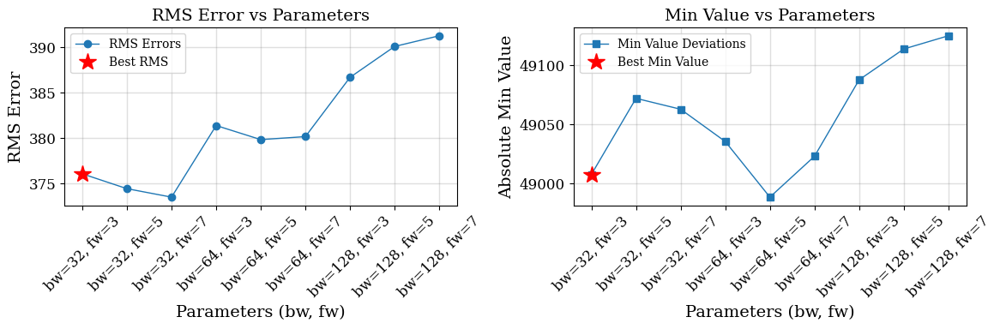

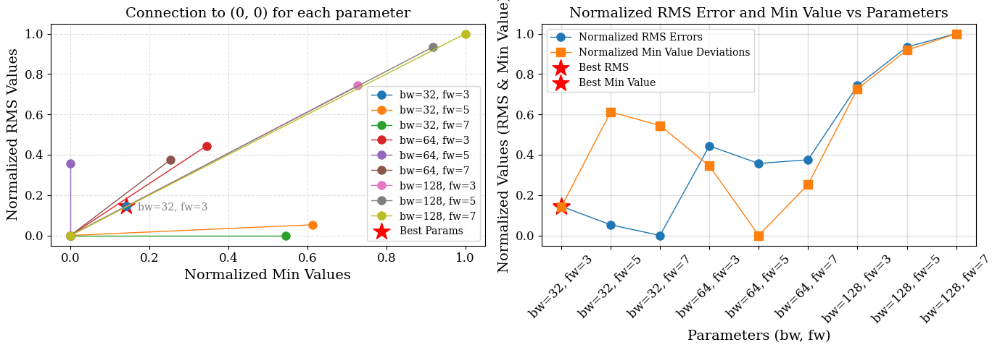

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_23-24.09.1987_10m_19S-3-2.fit


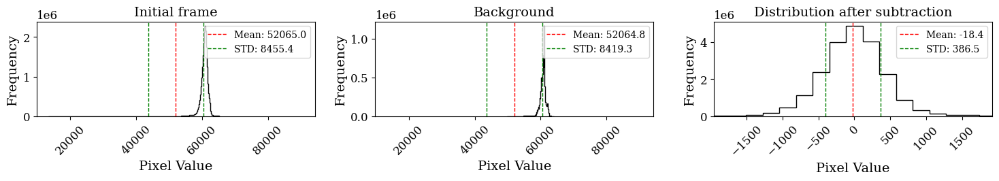

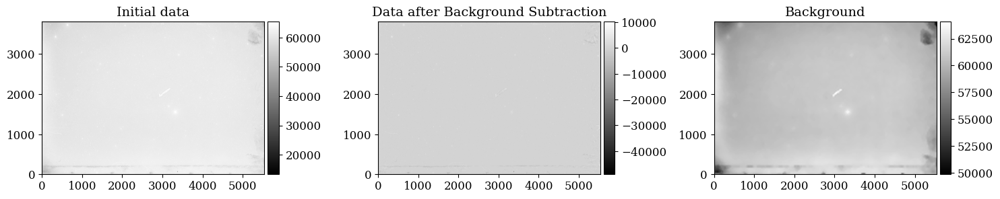

thresh  359.44389152526855
10686 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  353.8294925689697
9718 objects found in segment 2


thresh  358.4538326263428
13441 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  358.6113986968994
11182 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  45027


Processing files:   0%|                       | 1/264 [00:58<4:15:16, 58.24s/it]

Processed Sky_23-24.09.1987_10m_19S-3-2.fit (1/264) in 58.24 seconds.
-------------------------------------------


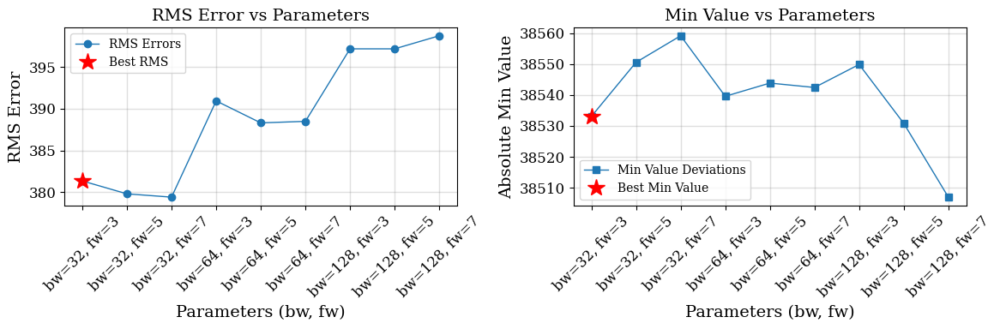

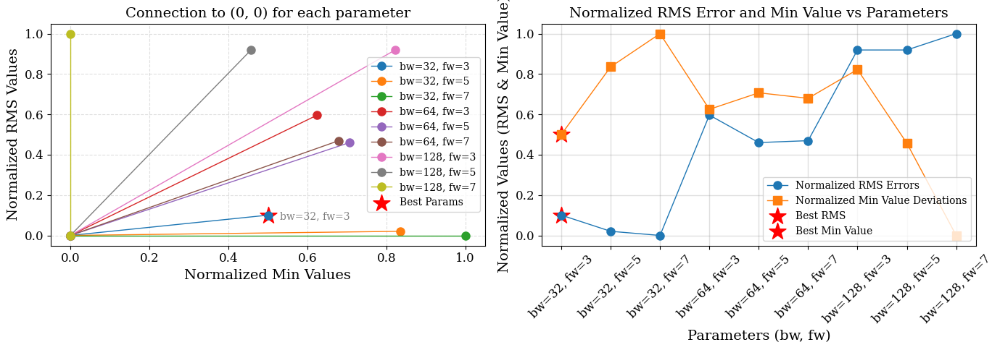

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_23-24.09.1987_10m_19S-3-4.fit


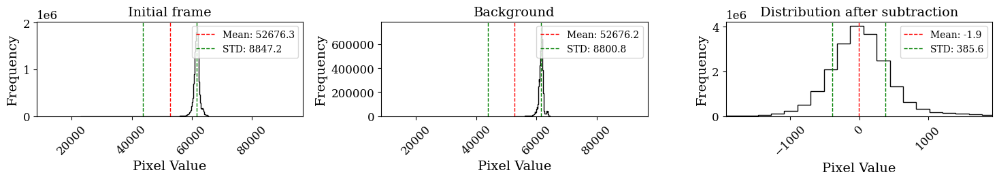

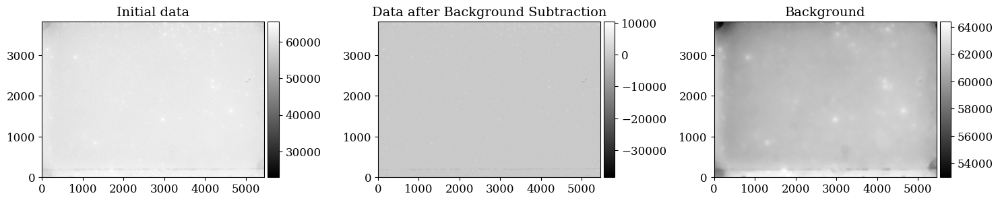

thresh  382.29633152484894
11606 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  369.96114444732666
8825 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  395.21299743652344
14617 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  378.6917836666107
10507 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  45555


Processing files:   1%|▏                      | 2/264 [01:55<4:13:00, 57.94s/it]

Processed Sky_23-24.09.1987_10m_19S-3-4.fit (2/264) in 57.73 seconds.
-------------------------------------------


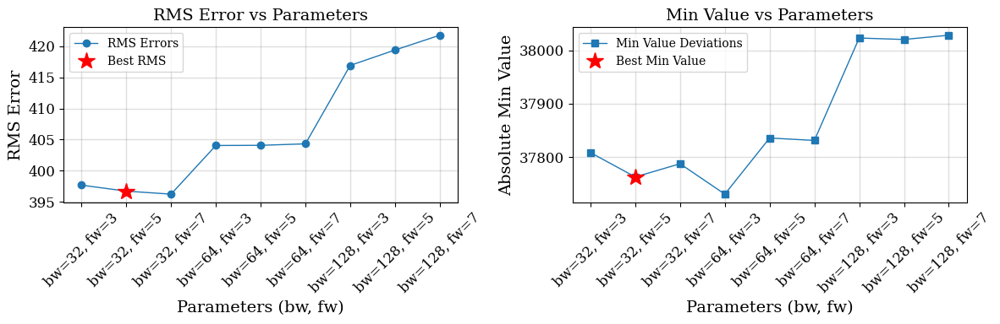

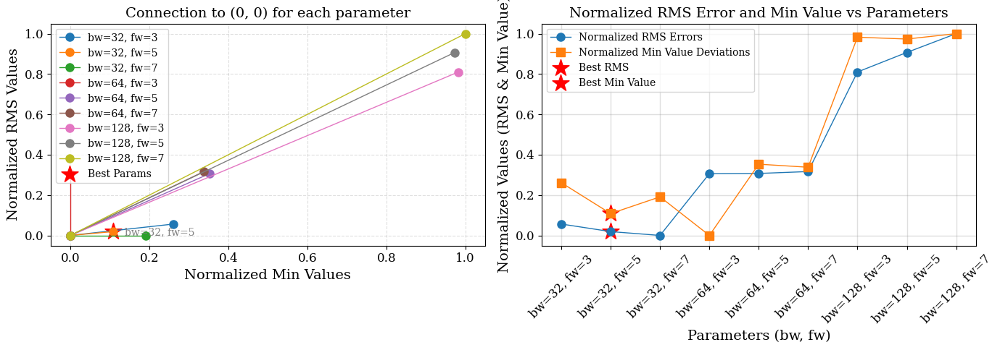

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_23-24.09.1987_10m_20S-2-1.fit


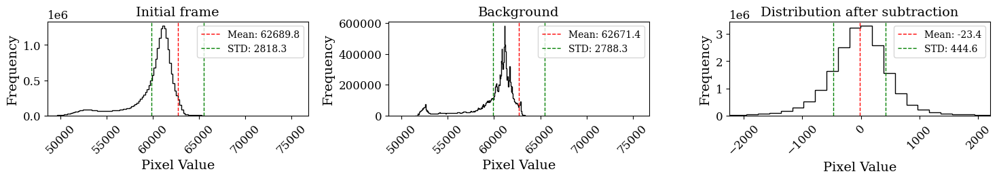

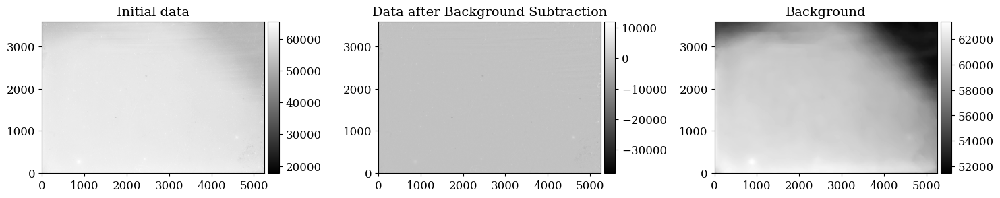

thresh  377.0029582977295
5786 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  373.1650733947754
10681 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  368.43236923217773
12189 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  363.8531684875488
19070 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  47726


Processing files:   1%|▎                      | 3/264 [02:53<4:12:12, 57.98s/it]

Processed Sky_23-24.09.1987_10m_20S-2-1.fit (3/264) in 58.03 seconds.
-------------------------------------------


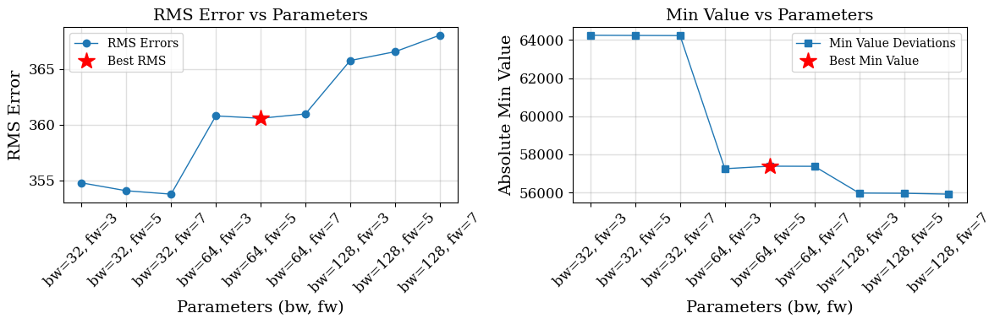

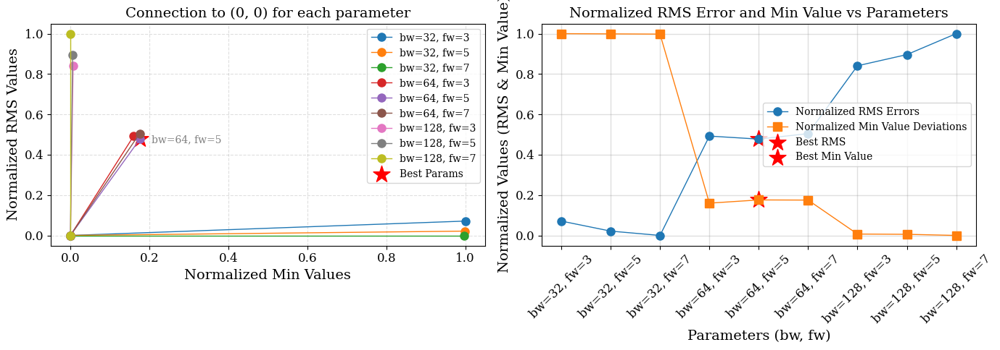

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_23-24.09.1987_10m_20S-2-2.fit


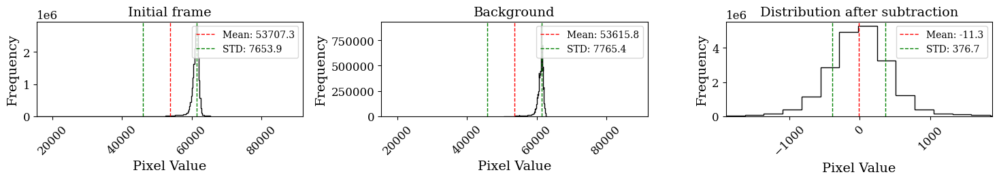

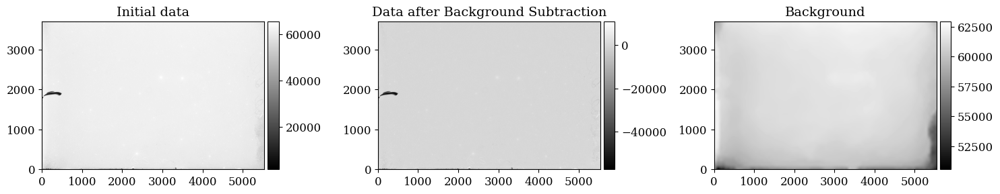

thresh  352.2639207839966
11876 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  348.32536697387695
11490 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  345.4346618652344
9090 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  350.050612449646
8657 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  41113


Processing files:   2%|▎                      | 4/264 [03:47<4:04:09, 56.34s/it]

Processed Sky_23-24.09.1987_10m_20S-2-2.fit (4/264) in 53.83 seconds.
-------------------------------------------


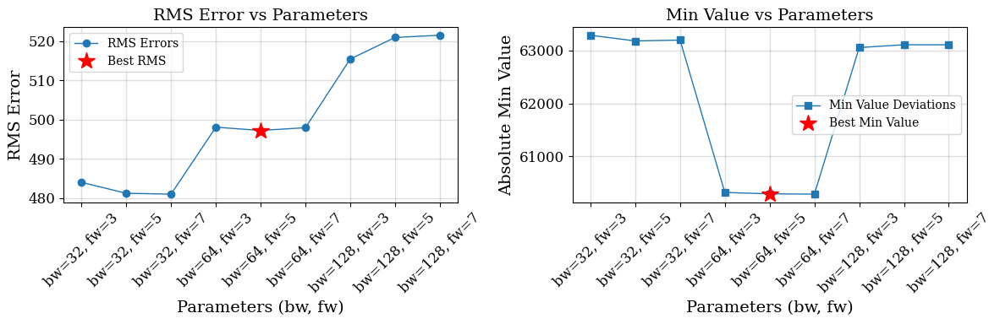

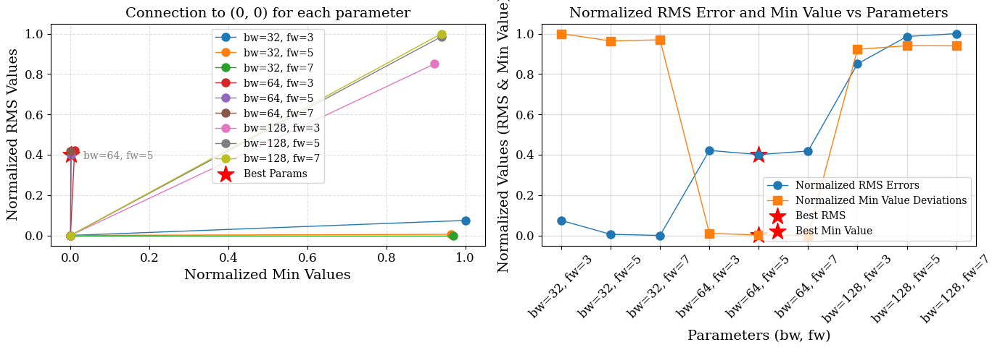

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_23-24.09.1987_10m_20S-2-3.fit


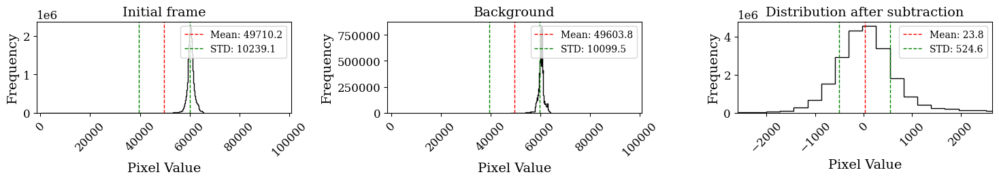

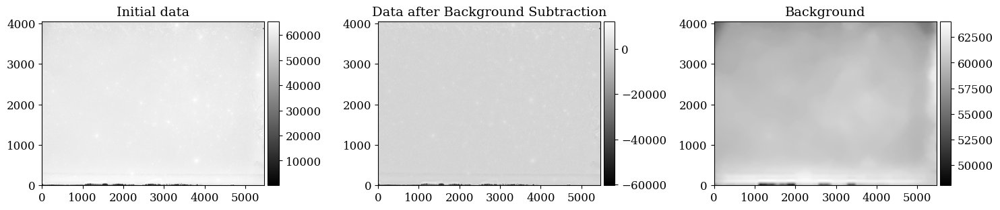

thresh  508.6358013153076
8296 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  545.8496322631836
10699 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  502.60830545425415
11791 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  538.5177917480469
13542 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  44328


Processing files:   2%|▍                      | 5/264 [04:45<4:05:52, 56.96s/it]

Processed Sky_23-24.09.1987_10m_20S-2-3.fit (5/264) in 58.05 seconds.
-------------------------------------------


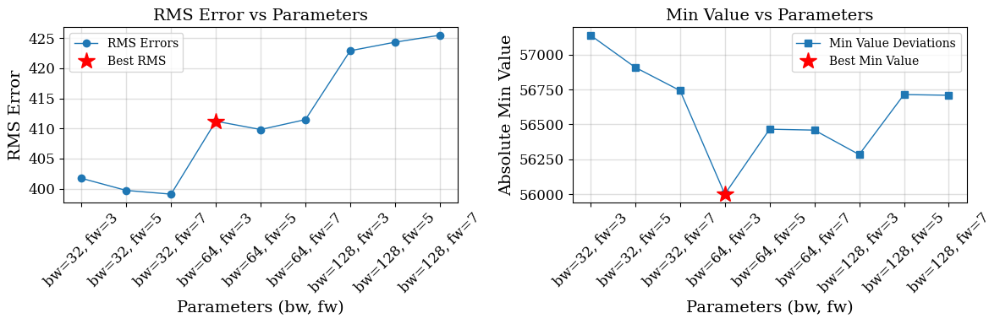

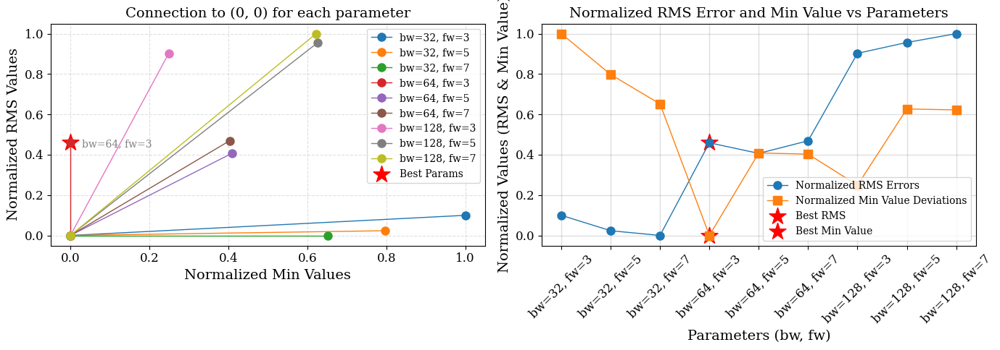

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_23-24.09.1987_10m_20S-3-1.fit


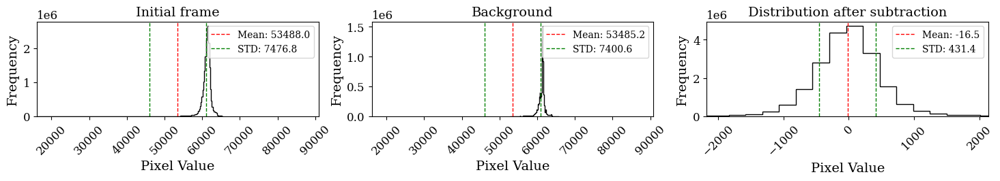

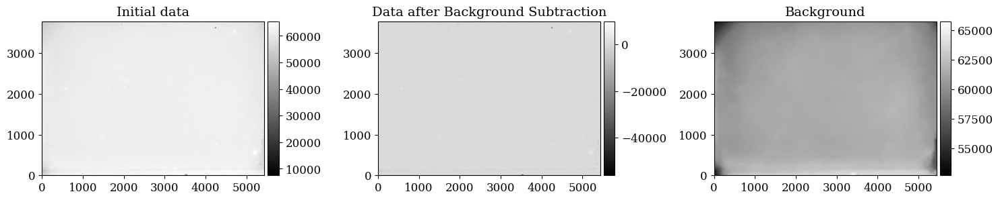

thresh  414.1598801612854
20539 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  388.9435749053955
7532 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  392.23161697387695
13017 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  389.90693855285645
8991 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  50079


Processing files:   2%|▌                      | 6/264 [05:48<4:12:38, 58.75s/it]

Processed Sky_23-24.09.1987_10m_20S-3-1.fit (6/264) in 62.23 seconds.
-------------------------------------------


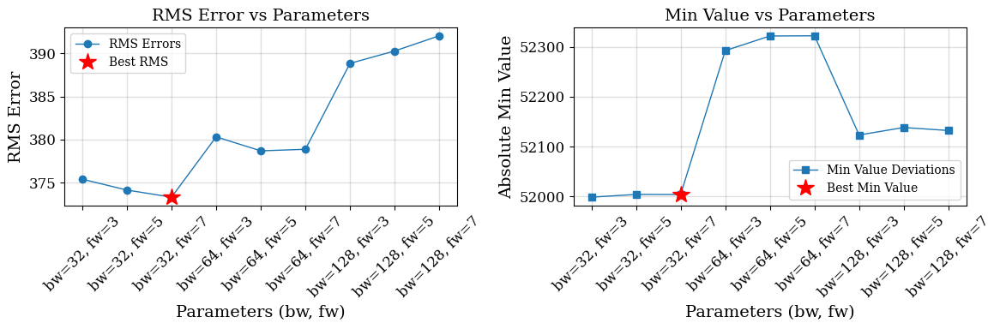

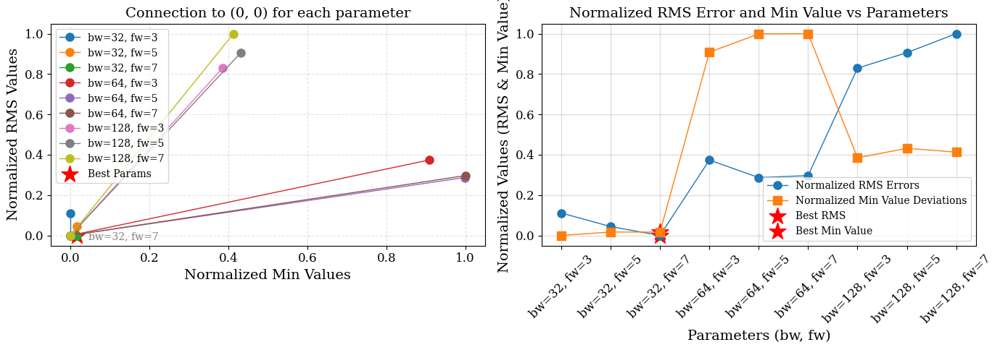

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_23-24.09.1987_10m_20S-3-2.fit


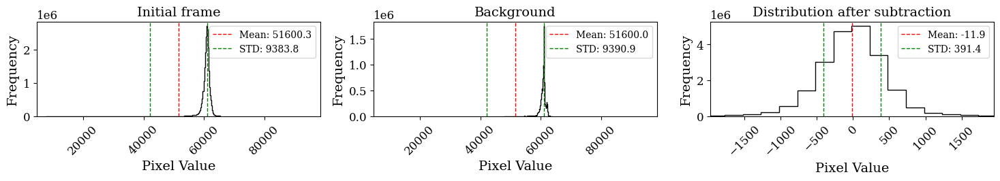

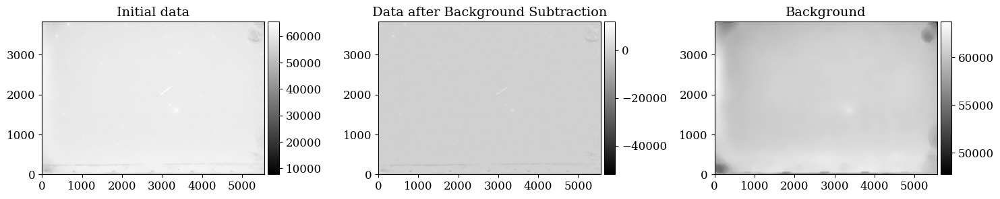

thresh  366.36587047576904
9517 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  365.4020195007324
8825 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  356.3081455230713
12861 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  356.8286895751953
11264 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  42467


Processing files:   3%|▌                      | 7/264 [06:43<4:06:52, 57.64s/it]

Processed Sky_23-24.09.1987_10m_20S-3-2.fit (7/264) in 55.34 seconds.
-------------------------------------------


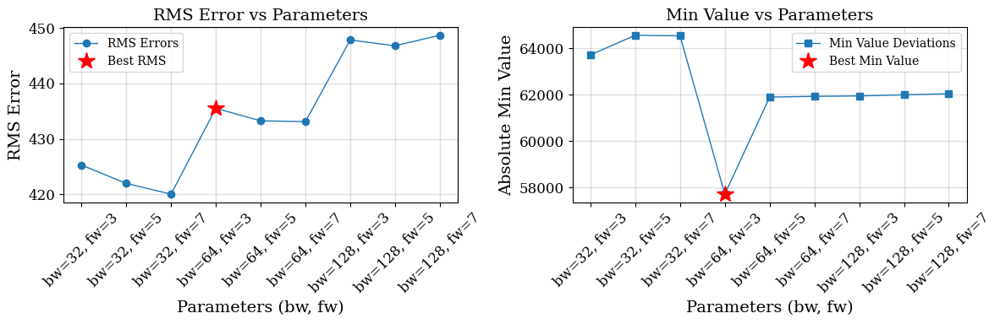

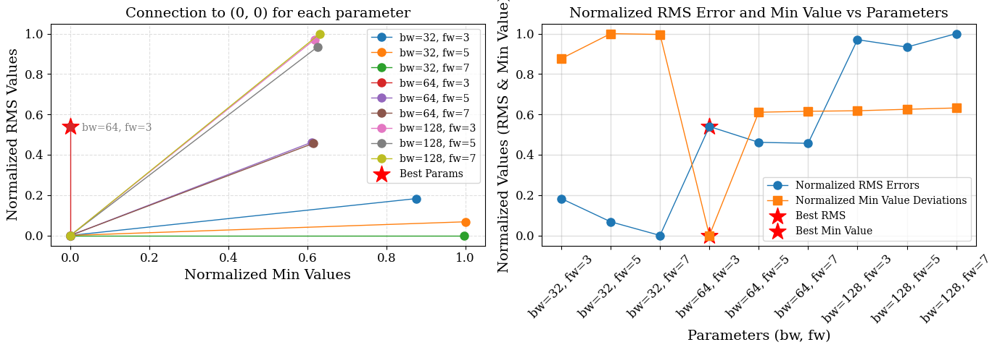

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_23-24.09.1987_12m_20S-3-3.fit


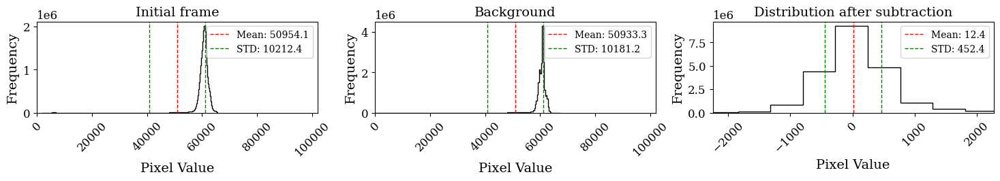

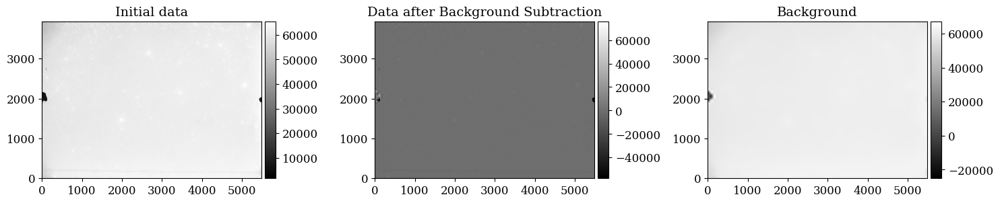

thresh  437.4437025785446
10203 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  432.9701566696167
10519 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  464.9730911254883
11393 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  464.5201759338379
9476 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  41591


Processing files:   3%|▋                      | 8/264 [07:38<4:02:44, 56.89s/it]

Processed Sky_23-24.09.1987_12m_20S-3-3.fit (8/264) in 55.29 seconds.
-------------------------------------------


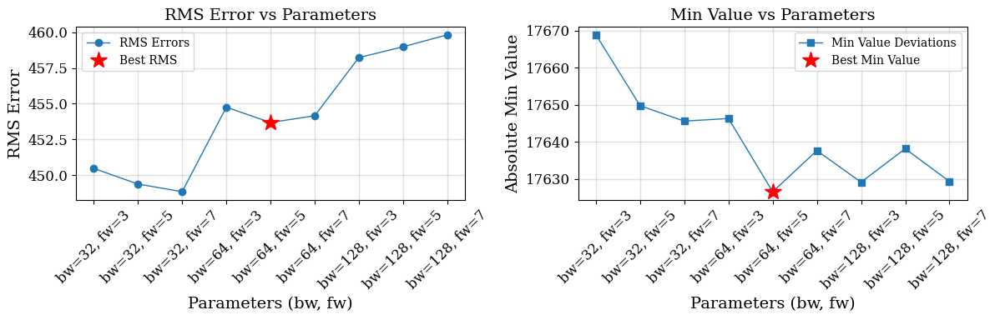

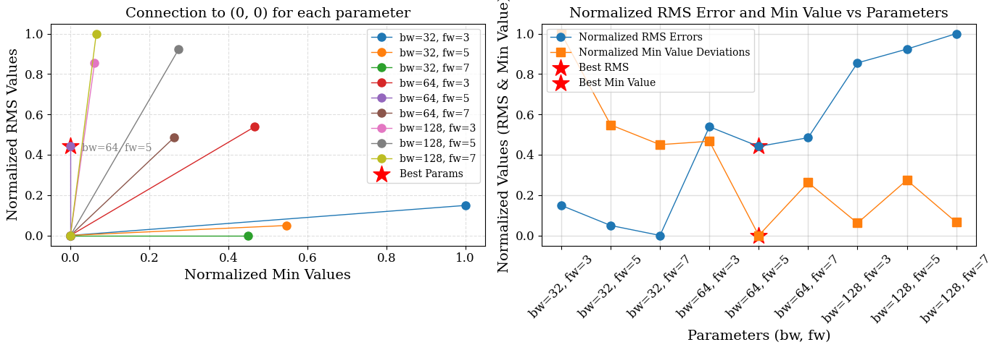

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-2-1.fit


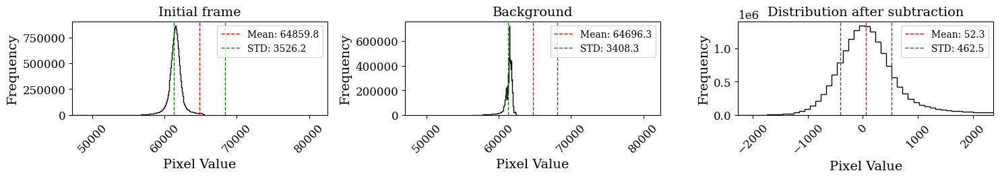

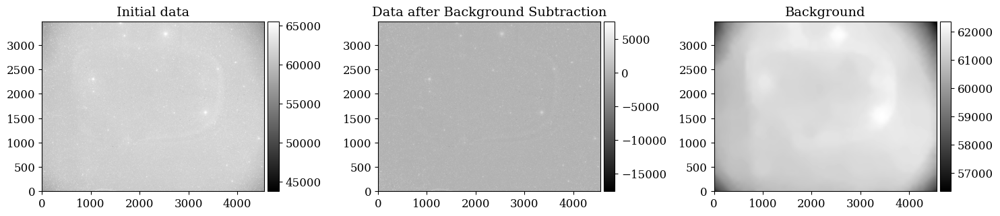

thresh  508.4153022766113
15154 objects found in segment 1


thresh  518.095085144043
15810 objects found in segment 2


thresh  499.525146484375
13805 objects found in segment 3


thresh  505.07850646972656
13664 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  58433


Processing files:   3%|▊                      | 9/264 [08:44<4:13:11, 59.58s/it]

Processed sky_24-25.01.1987_10m_7S-2-1.fit (9/264) in 65.48 seconds.
-------------------------------------------


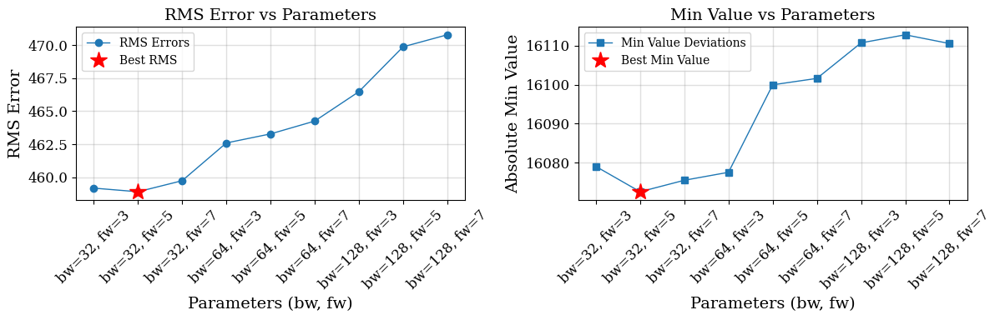

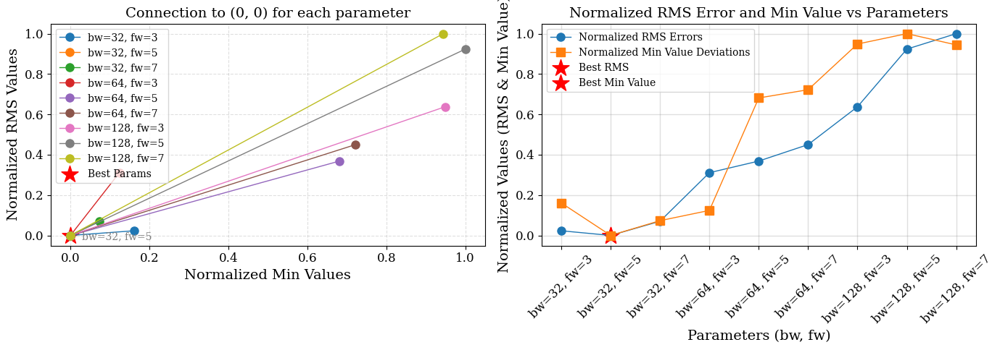

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-2-2.fit


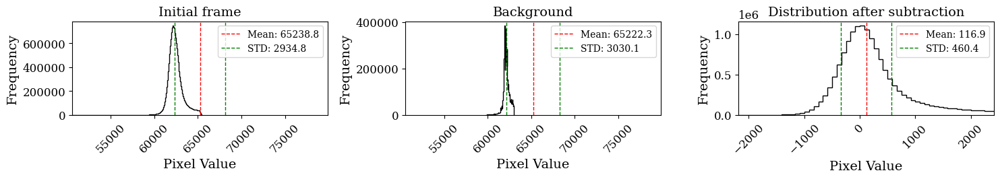

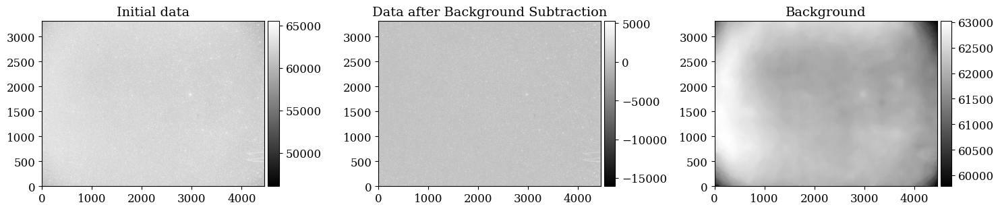

thresh  605.2872314453125
16800 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  586.0989608764648
15802 objects found in segment 2


thresh  582.0271148681641
16136 objects found in segment 3


thresh  546.7141952514648
14583 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  63321


Processing files:   4%|▊                     | 10/264 [09:53<4:25:04, 62.61s/it]

Processed sky_24-25.01.1987_10m_7S-2-2.fit (10/264) in 69.42 seconds.
-------------------------------------------


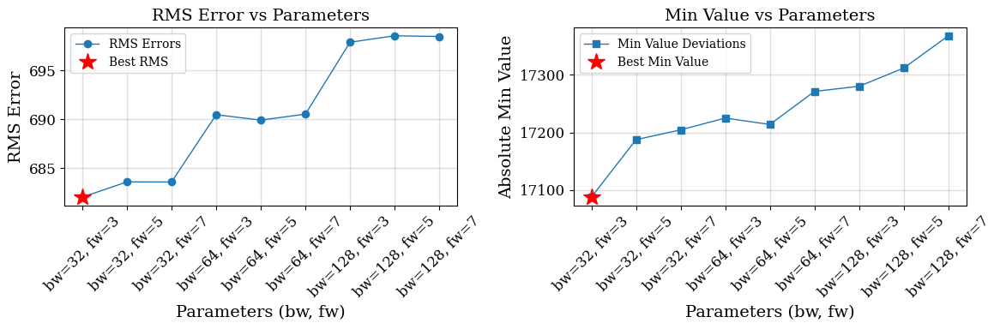

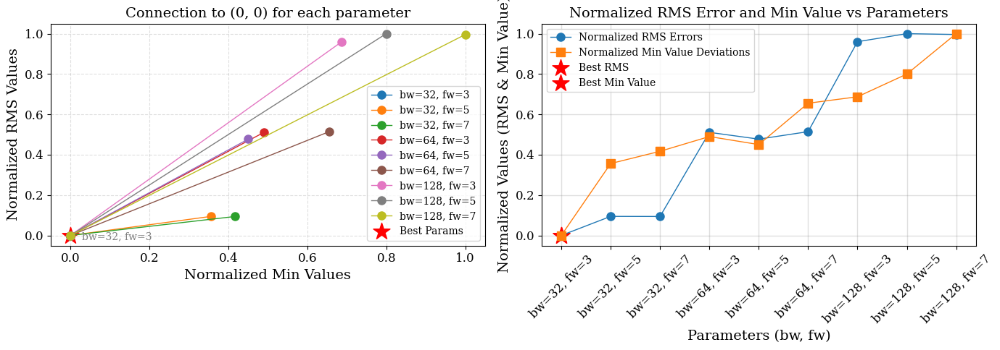

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-2-4.fit


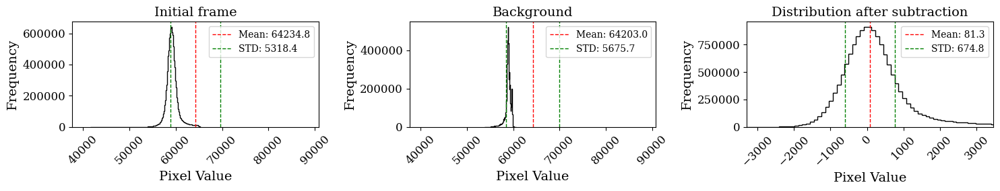

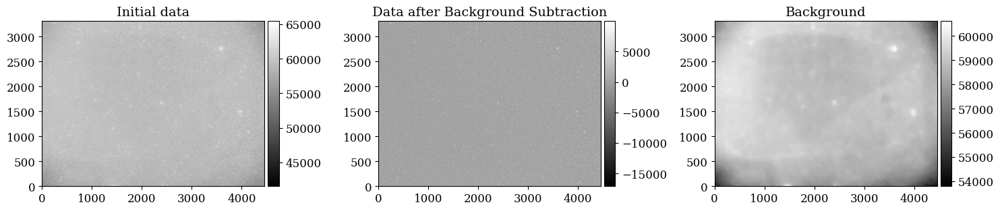

thresh  736.4164352416992
13575 objects found in segment 1


thresh  792.6783142089844
16377 objects found in segment 2


thresh  737.379581451416
13376 objects found in segment 3


thresh  810.8963165283203
16606 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  59934


Processing files:   4%|▉                     | 11/264 [11:00<4:29:59, 64.03s/it]

Processed sky_24-25.01.1987_10m_7S-2-4.fit (11/264) in 67.24 seconds.
-------------------------------------------


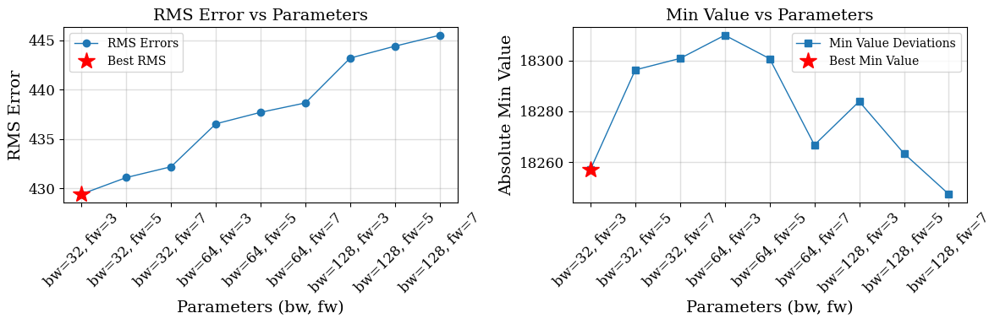

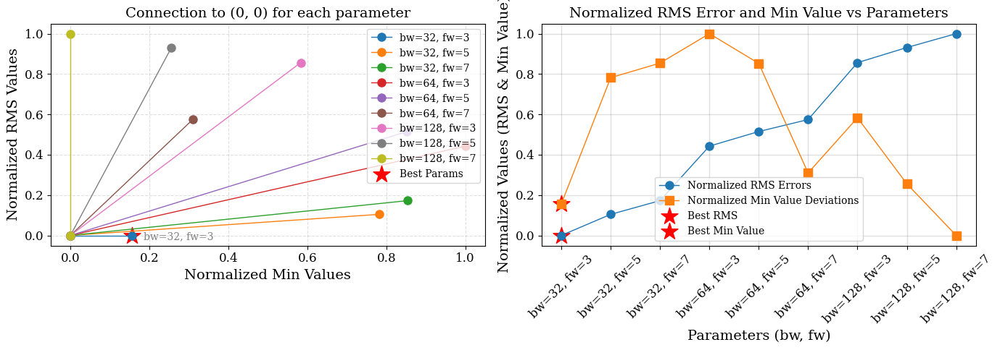

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-2-5.fit


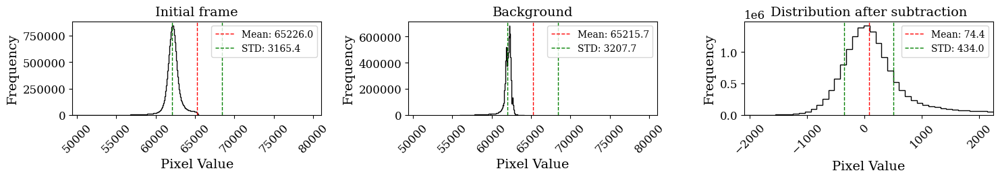

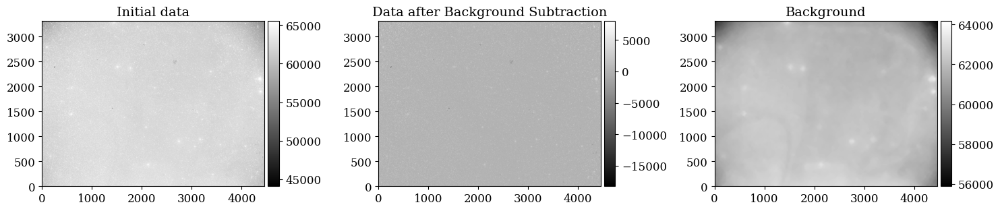

thresh  537.8914260864258
16156 objects found in segment 1


thresh  469.6448440551758
13541 objects found in segment 2


thresh  551.3162536621094
15590 objects found in segment 3


thresh  482.09014892578125
13576 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  58863


Processing files:   5%|█                     | 12/264 [12:07<4:31:40, 64.69s/it]

Processed sky_24-25.01.1987_10m_7S-2-5.fit (12/264) in 66.19 seconds.
-------------------------------------------


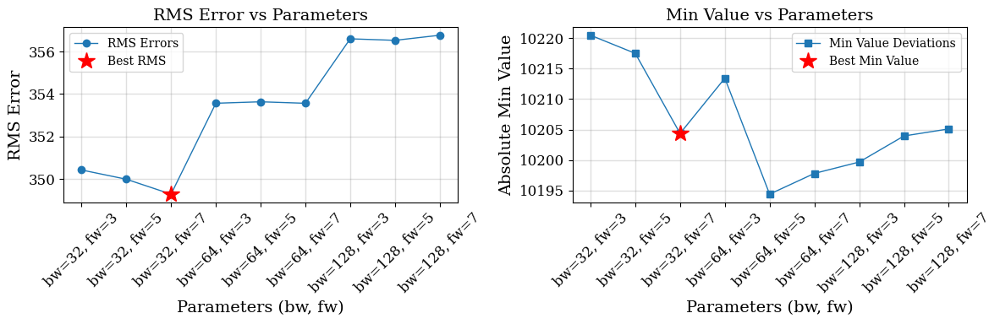

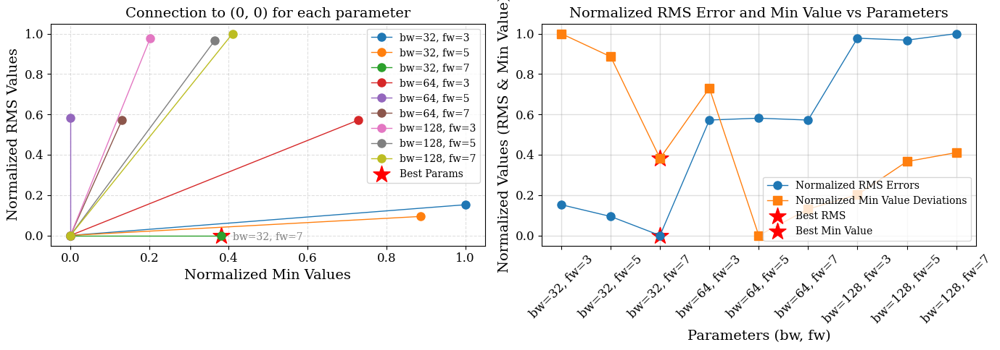

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-2-6.fit


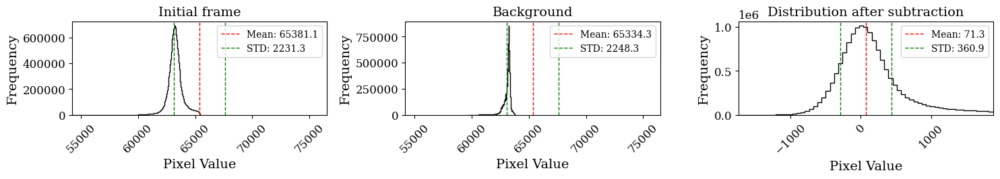

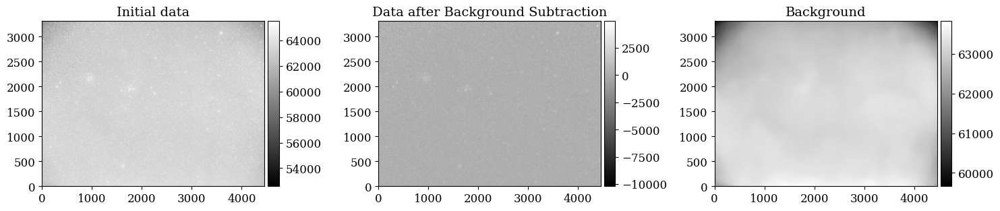

thresh  418.162841796875
15901 objects found in segment 1


thresh  411.6501159667969
16637 objects found in segment 2


thresh  448.6011962890625
16291 objects found in segment 3


thresh  416.27425384521484
16443 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  65272


Processing files:   5%|█                     | 13/264 [13:19<4:40:53, 67.15s/it]

Processed sky_24-25.01.1987_10m_7S-2-6.fit (13/264) in 72.81 seconds.
-------------------------------------------


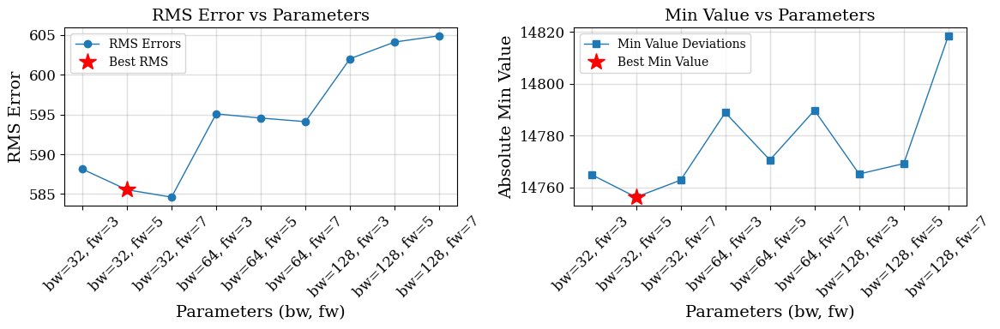

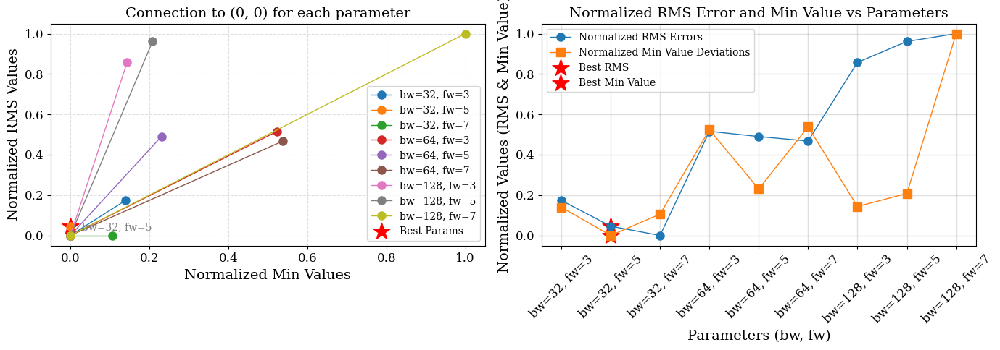

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-2-7.fit


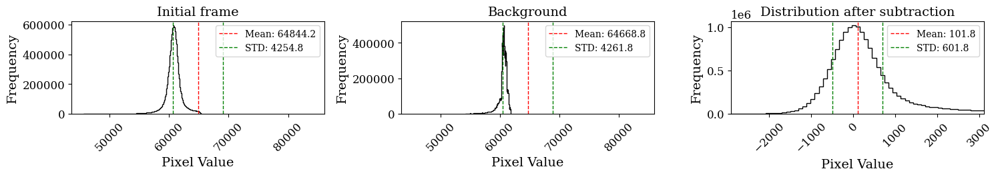

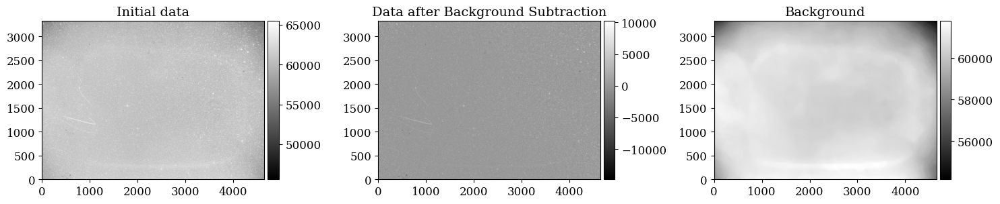

thresh  655.8287124633789
15417 objects found in segment 1


thresh  725.54345703125
18083 objects found in segment 2


thresh  650.661247253418
15866 objects found in segment 3


thresh  750.2961273193359
18039 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  67405


Processing files:   5%|█▏                    | 14/264 [14:35<4:50:07, 69.63s/it]

Processed sky_24-25.01.1987_10m_7S-2-7.fit (14/264) in 75.37 seconds.
-------------------------------------------


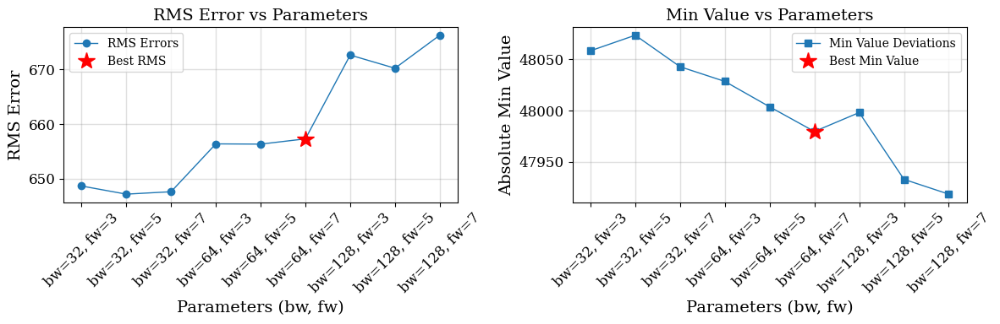

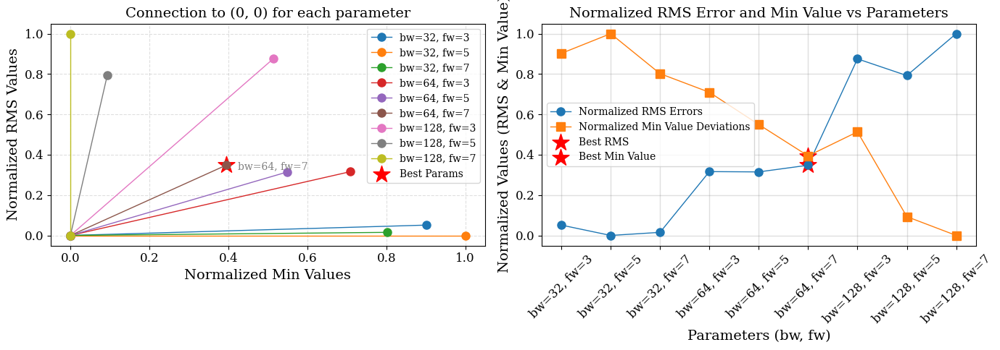

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-2-8.fit


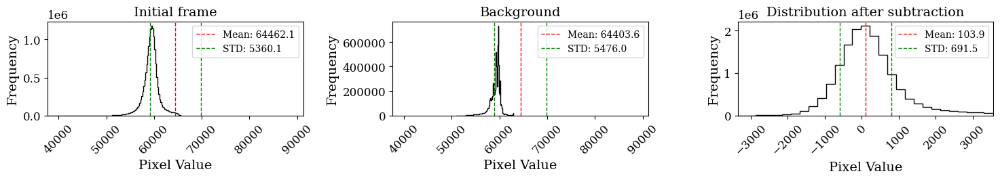

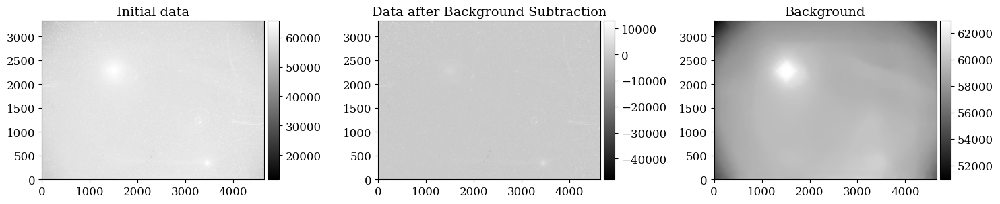

thresh  699.5765762329102
14111 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  782.465217590332
13552 objects found in segment 2


thresh  824.3157806396484
11520 objects found in segment 3


thresh  756.8672256469727
16656 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  55839


Processing files:   6%|█▎                    | 15/264 [15:39<4:42:50, 68.16s/it]

Processed sky_24-25.01.1987_10m_7S-2-8.fit (15/264) in 64.74 seconds.
-------------------------------------------


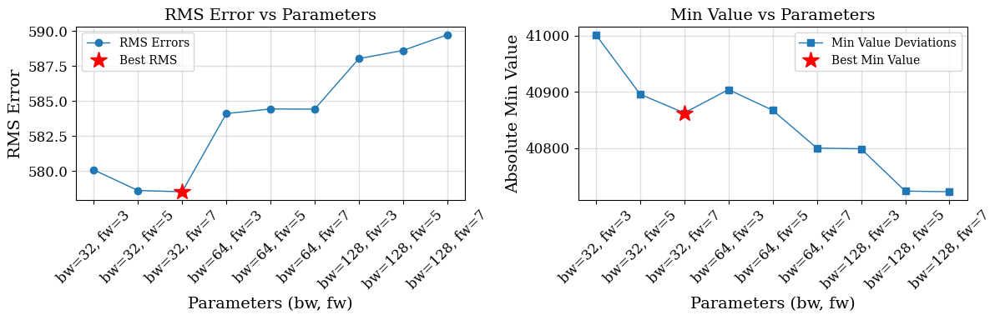

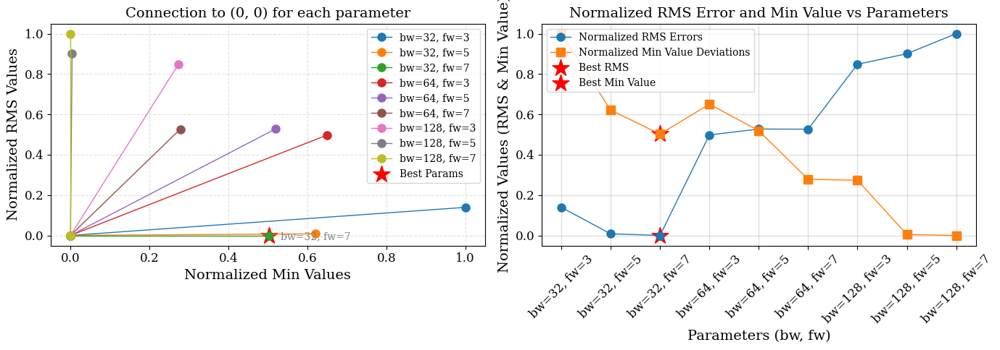

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-2-9.fit


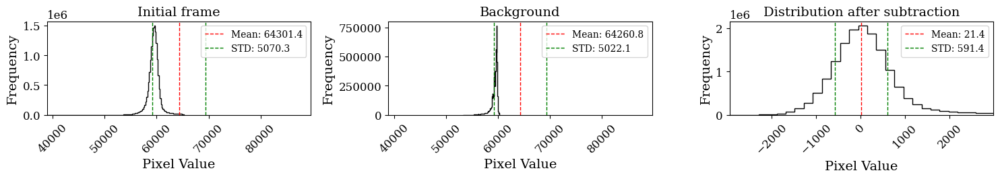

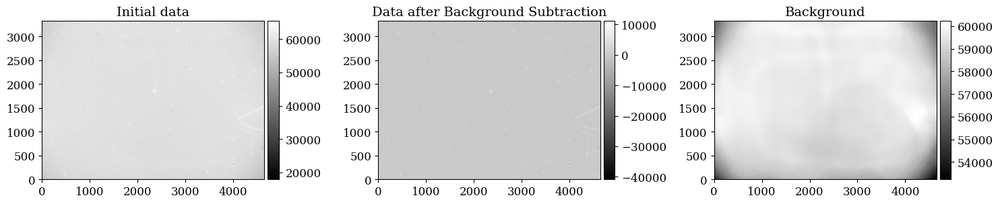

thresh  590.998327255249
12649 objects found in segment 1


thresh  615.2489929199219
13787 objects found in segment 2


thresh  594.2182245254517
12471 objects found in segment 3


thresh  606.4066696166992
13989 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  52896


Processing files:   6%|█▎                    | 16/264 [16:41<4:33:51, 66.26s/it]

Processed sky_24-25.01.1987_10m_7S-2-9.fit (16/264) in 61.85 seconds.
-------------------------------------------


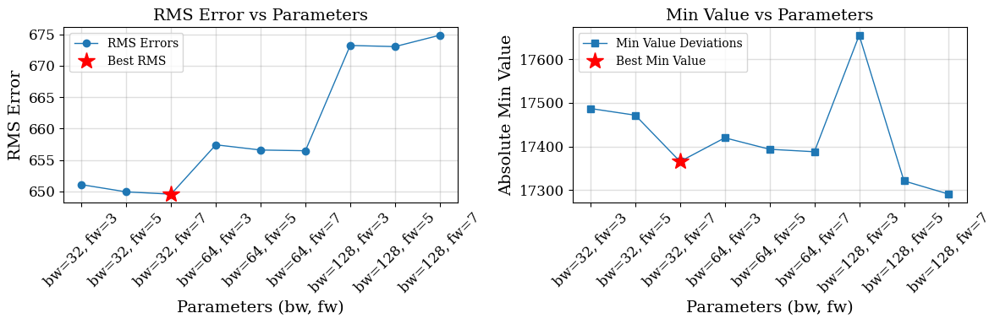

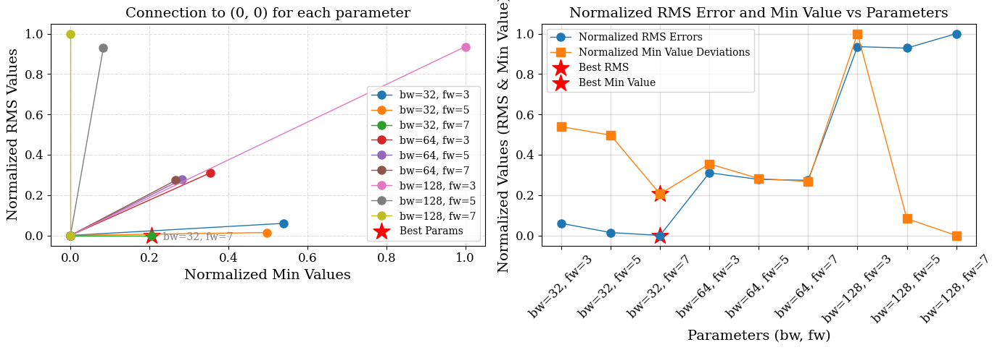

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-2-10.fit


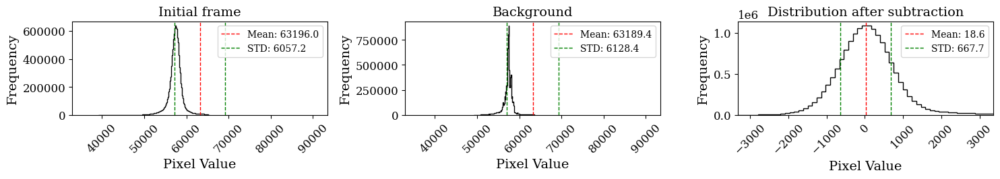

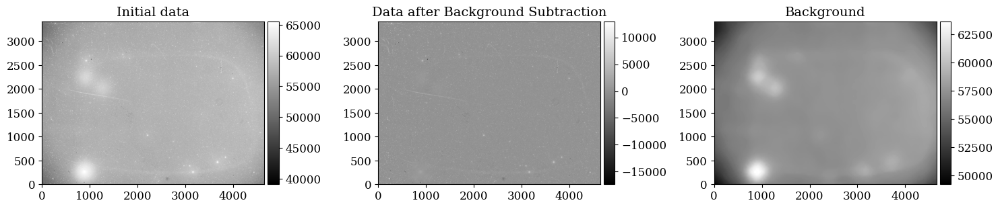

thresh  683.0845756530762
9958 objects found in segment 1


thresh  662.9792308807373
11318 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  671.0324516296387
10040 objects found in segment 3


thresh  658.2148895263672
12048 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  43364


Processing files:   6%|█▍                    | 17/264 [17:35<4:16:48, 62.38s/it]

Processed sky_24-25.01.1987_10m_7S-2-10.fit (17/264) in 53.37 seconds.
-------------------------------------------


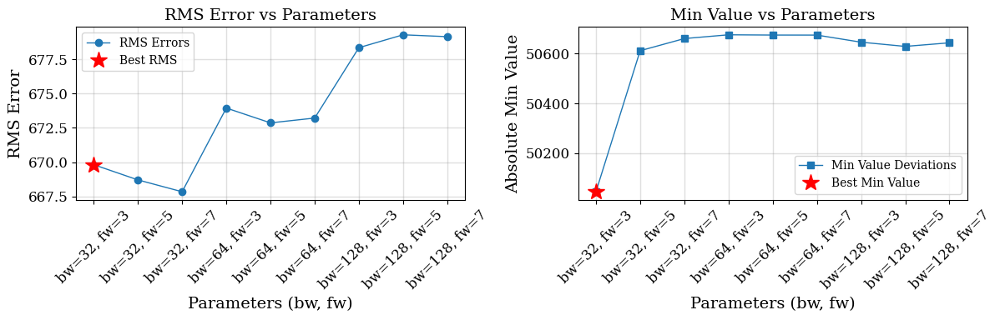

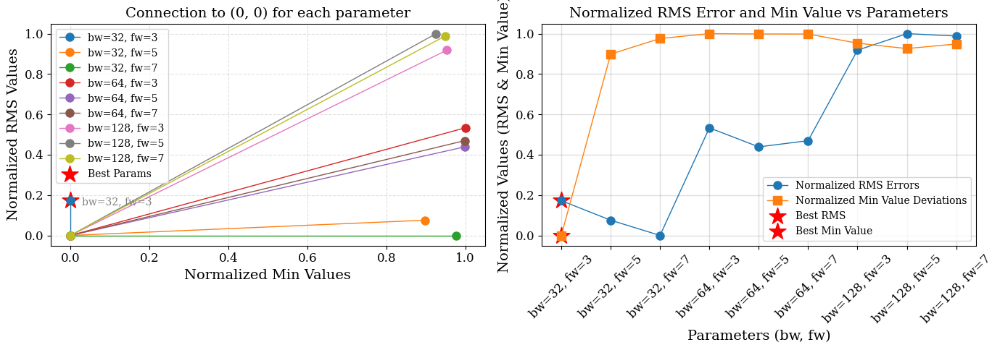

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-2-11.fit


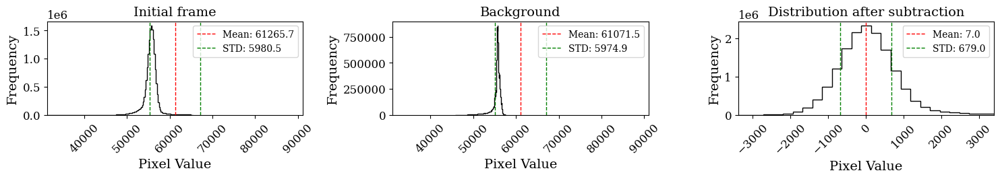

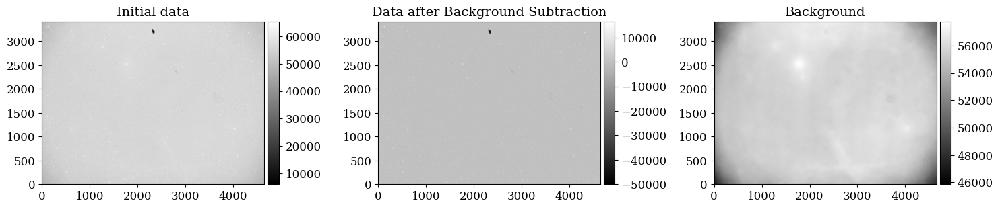

thresh  677.294234752655
8761 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  677.8414754867554
10635 objects found in segment 2


thresh  675.3794612884521
9370 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  679.8134384155273
11114 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  39880


Processing files:   7%|█▌                    | 18/264 [18:23<3:58:41, 58.22s/it]

Processed sky_24-25.01.1987_10m_7S-2-11.fit (18/264) in 48.53 seconds.
-------------------------------------------


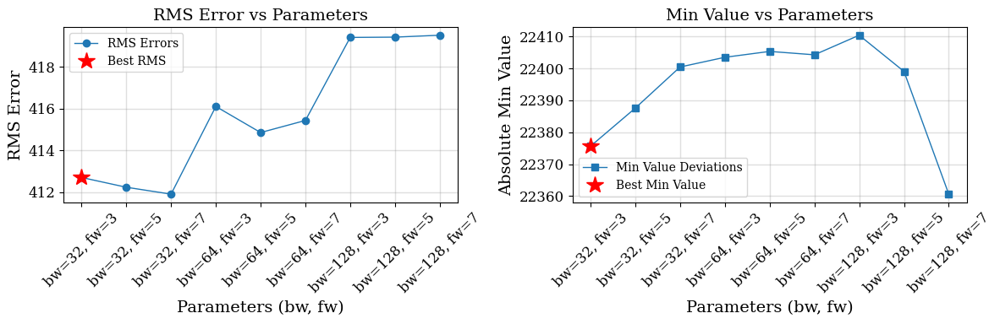

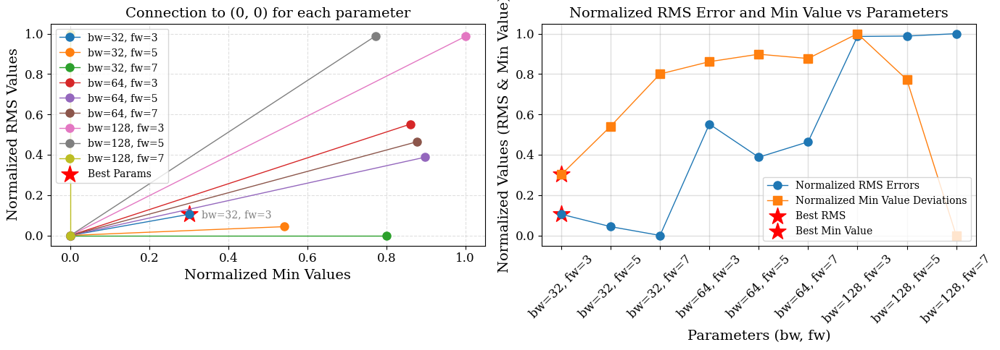

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-2-12.fit


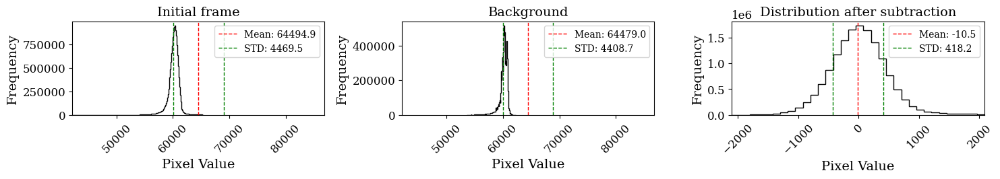

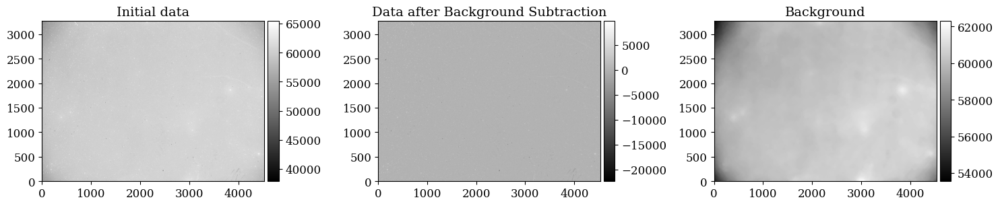

thresh  402.5872440338135
7465 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  398.4673433303833
7366 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  403.45187854766846
8962 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  405.21428203582764
8319 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  32112


Processing files:   7%|█▌                    | 19/264 [19:05<3:38:02, 53.40s/it]

Processed sky_24-25.01.1987_10m_7S-2-12.fit (19/264) in 42.17 seconds.
-------------------------------------------


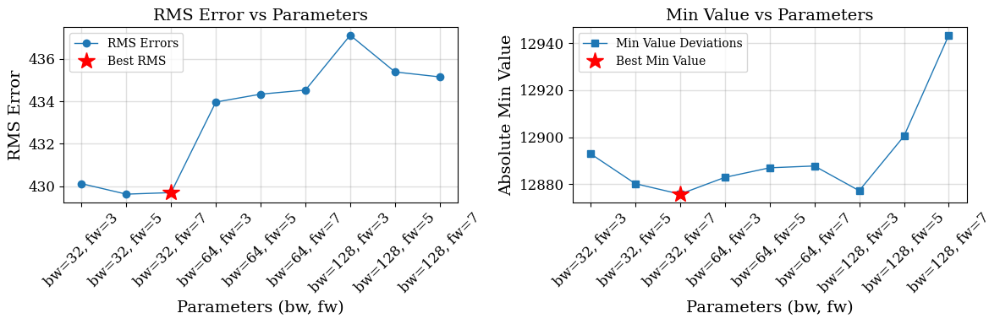

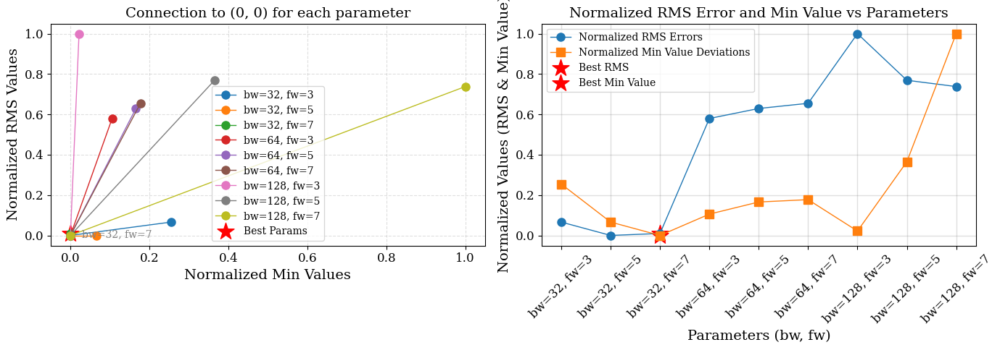

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-3-1.fit


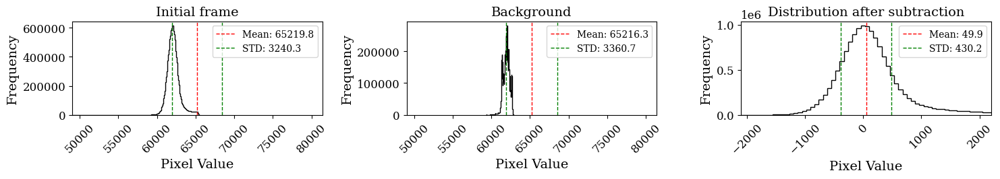

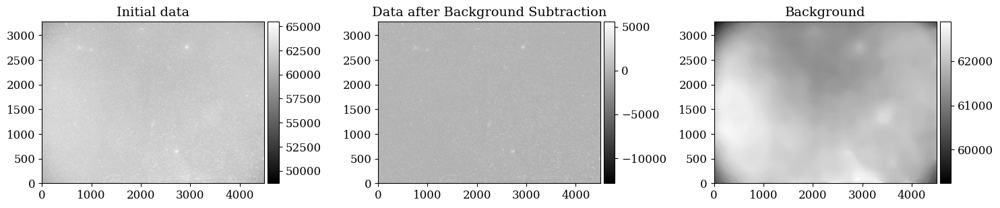

thresh  477.4251251220703
10534 objects found in segment 1


thresh  481.8827438354492
7585 objects found in segment 2


thresh  498.2186279296875
15405 objects found in segment 3


thresh  468.8661460876465
12224 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  45748


Processing files:   8%|█▋                    | 20/264 [19:59<3:37:43, 53.54s/it]

Processed sky_24-25.01.1987_10m_7S-3-1.fit (20/264) in 53.87 seconds.
-------------------------------------------


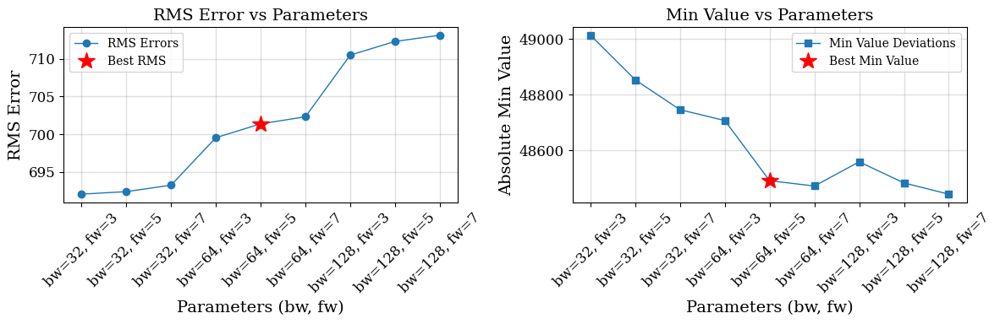

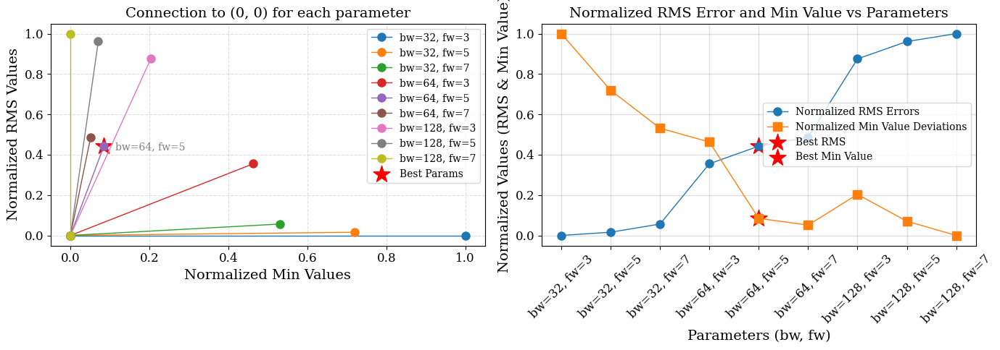

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-3-2.fit


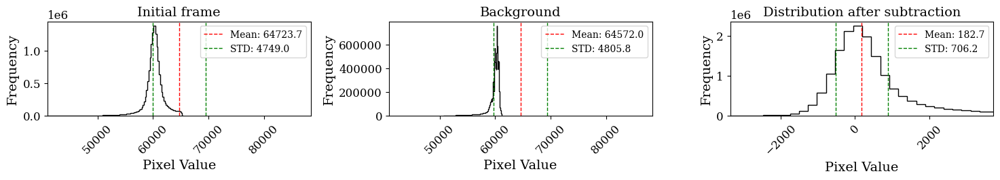

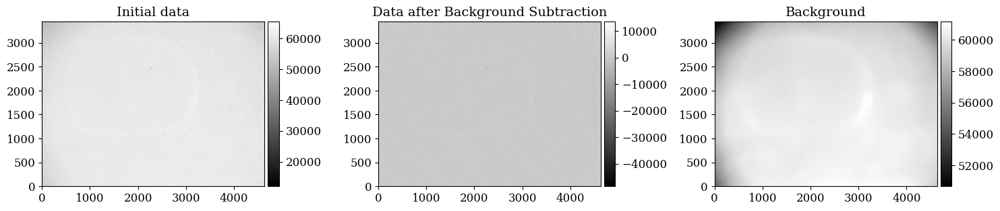

thresh  941.1128845214844
16319 objects found in segment 1


thresh  889.5850219726562
14538 objects found in segment 2


thresh  894.4881286621094
18091 objects found in segment 3


thresh  836.7659759521484
15948 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  64896


Processing files:   8%|█▊                    | 21/264 [21:12<4:00:29, 59.38s/it]

Processed sky_24-25.01.1987_10m_7S-3-2.fit (21/264) in 73.00 seconds.
-------------------------------------------


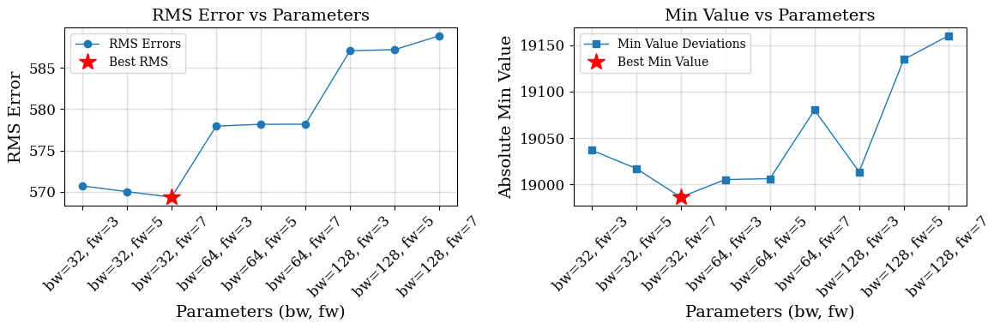

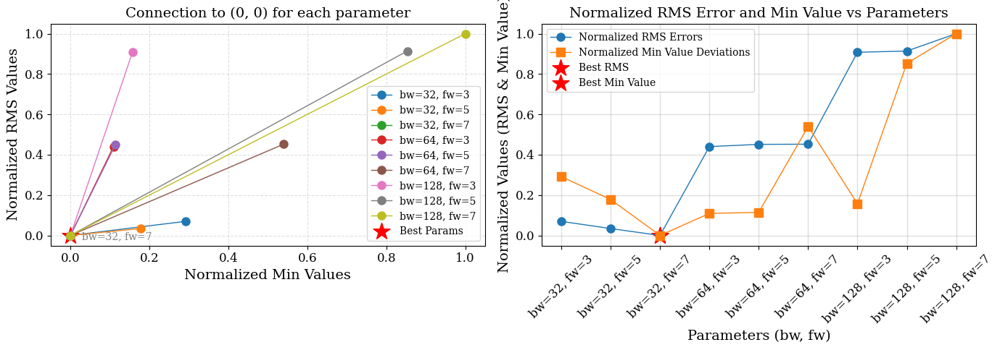

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-3-4.fit


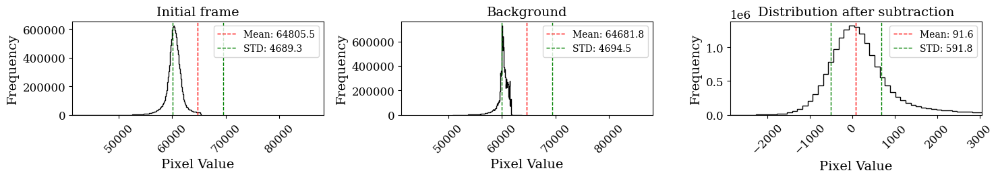

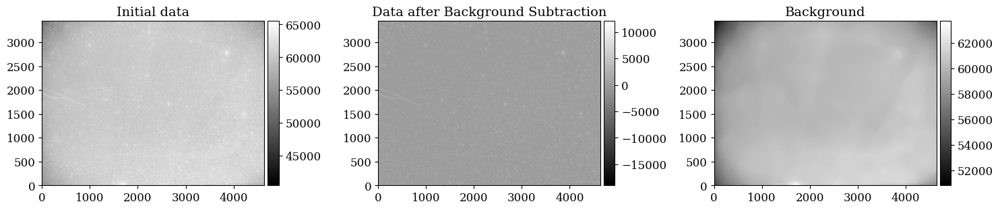

thresh  640.5890502929688
9553 objects found in segment 1


thresh  695.0291442871094
7779 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  634.065071105957
13904 objects found in segment 3


thresh  687.6098556518555
16042 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  47278


Processing files:   8%|█▊                    | 22/264 [22:10<3:57:49, 58.96s/it]

Processed sky_24-25.01.1987_10m_7S-3-4.fit (22/264) in 57.99 seconds.
-------------------------------------------


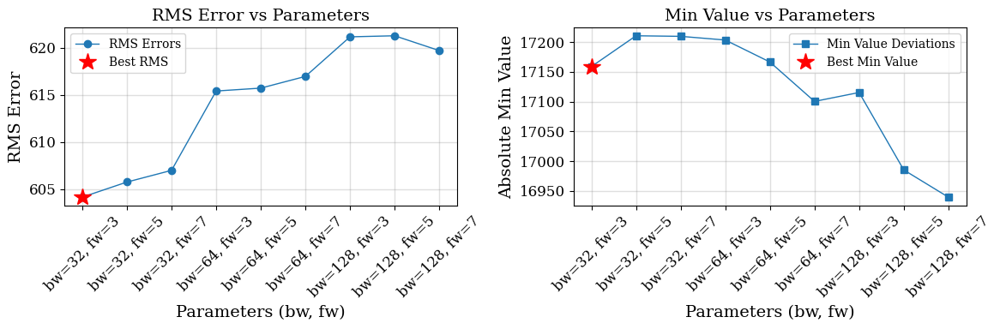

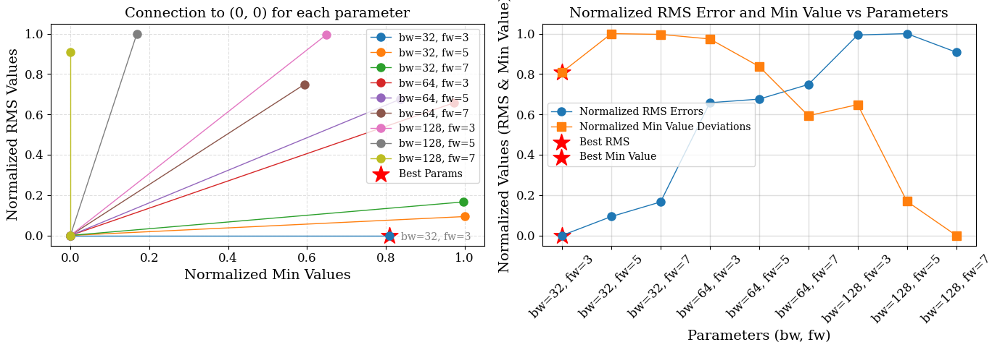

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-3-5.fit


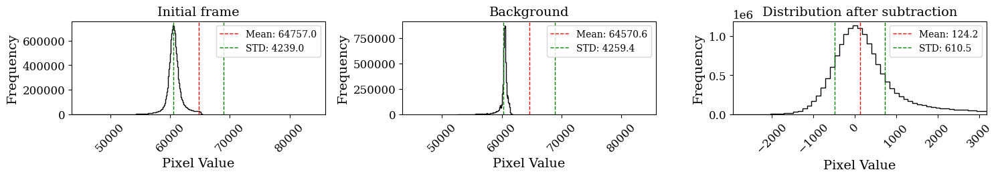

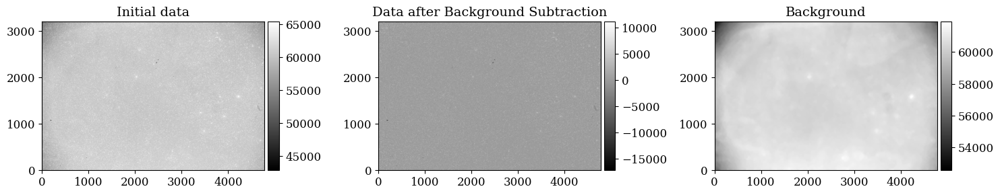

thresh  746.4481201171875
14735 objects found in segment 1


thresh  697.63671875
12944 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  731.9023056030273
17284 objects found in segment 3


thresh  757.9370574951172
17397 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  62360


Processing files:   9%|█▉                    | 23/264 [23:22<4:11:45, 62.68s/it]

Processed sky_24-25.01.1987_10m_7S-3-5.fit (23/264) in 71.33 seconds.
-------------------------------------------


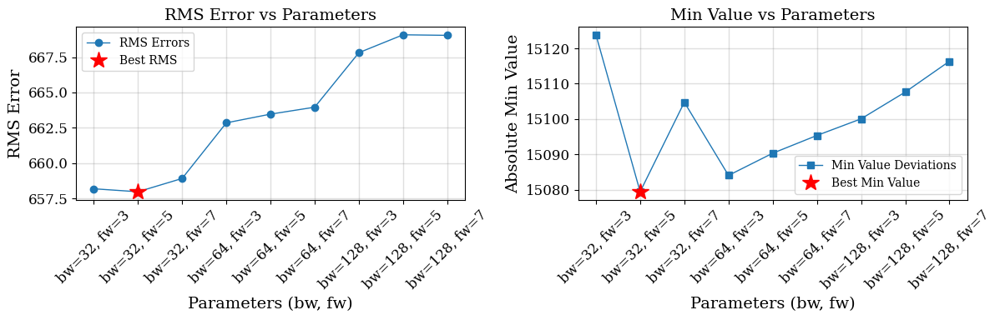

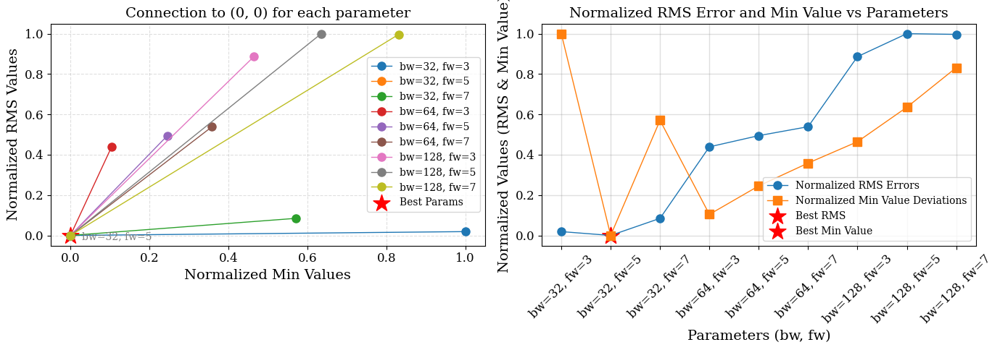

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-3-7.fit


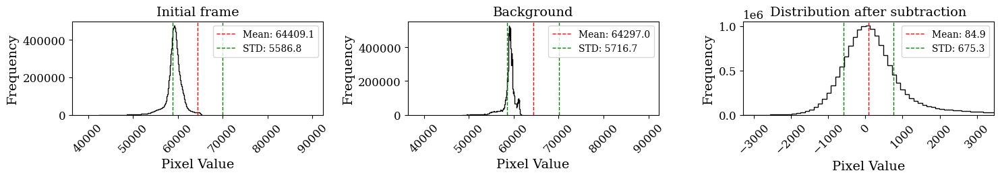

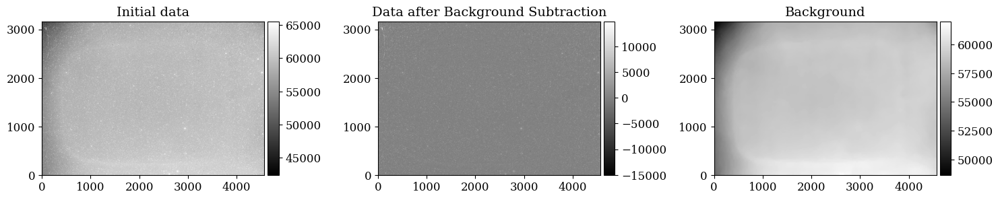

thresh  723.3819274902344
12354 objects found in segment 1


thresh  740.8059616088867
12147 objects found in segment 2


thresh  744.6868667602539
15945 objects found in segment 3


thresh  771.4417114257812
16132 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  56578


Processing files:   9%|██                    | 24/264 [24:25<4:12:01, 63.01s/it]

Processed sky_24-25.01.1987_10m_7S-3-7.fit (24/264) in 63.77 seconds.
-------------------------------------------


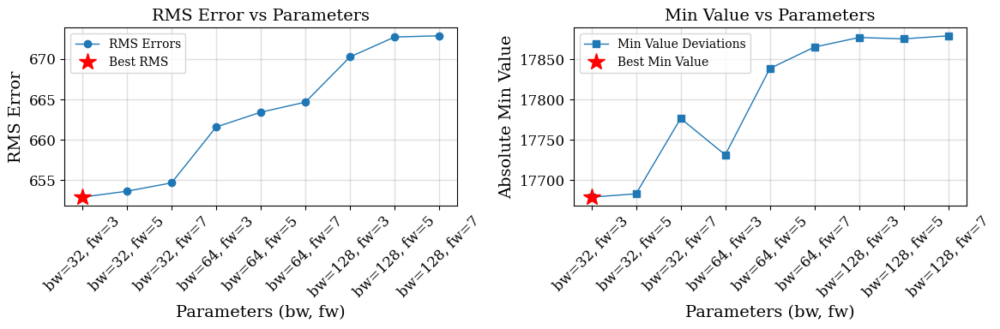

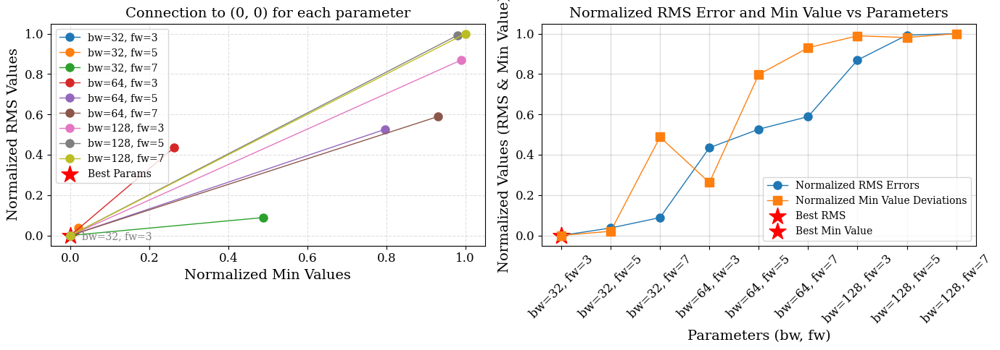

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-3-8.fit


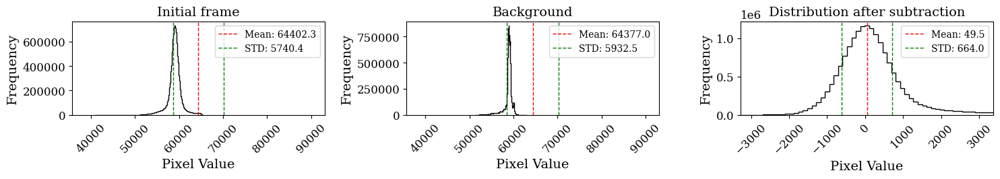

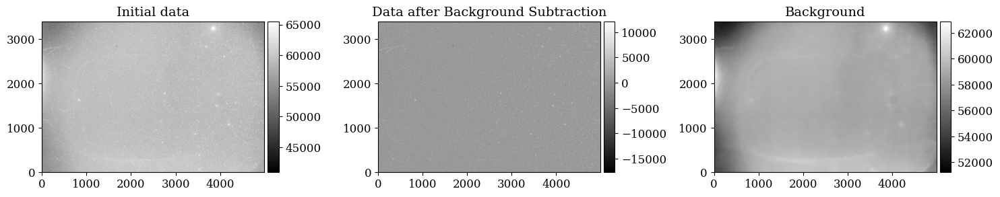

thresh  683.1391086578369
13836 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  721.6048355102539
14425 objects found in segment 2


thresh  683.5271339416504
15211 objects found in segment 3


thresh  733.41845703125
16861 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  60333


Processing files:   9%|██                    | 25/264 [25:33<4:16:50, 64.48s/it]

Processed sky_24-25.01.1987_10m_7S-3-8.fit (25/264) in 67.91 seconds.
-------------------------------------------


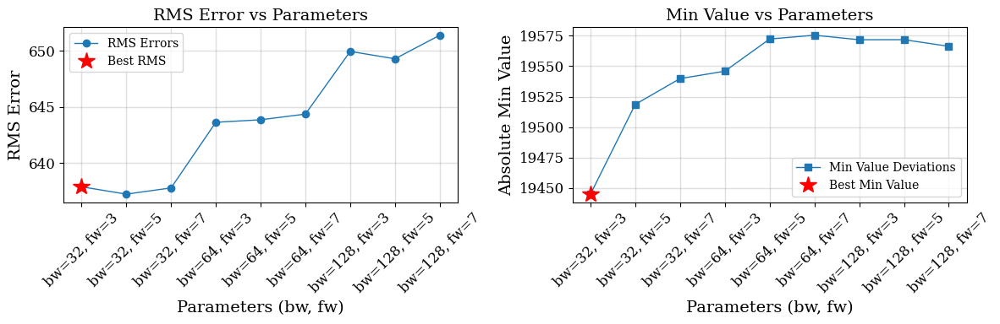

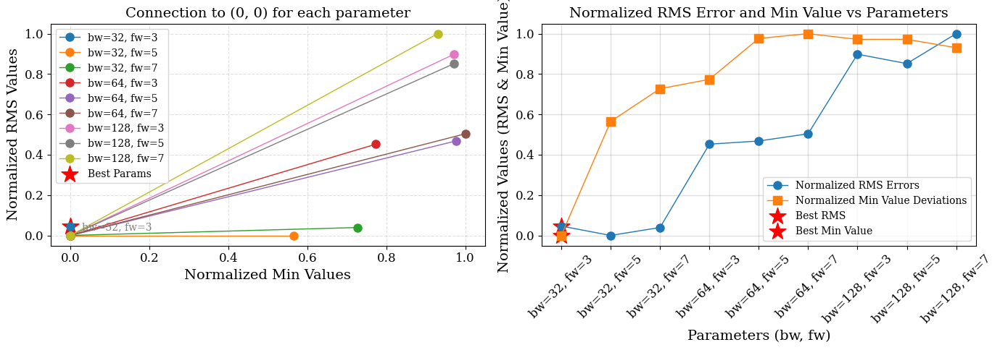

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-3-9.fit


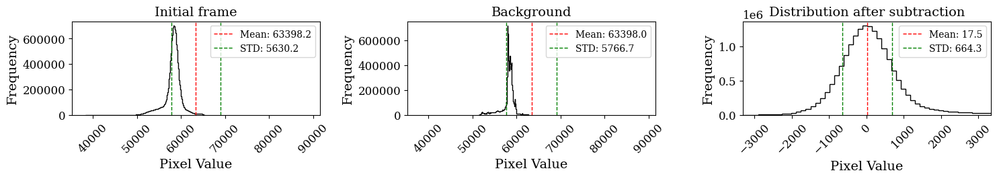

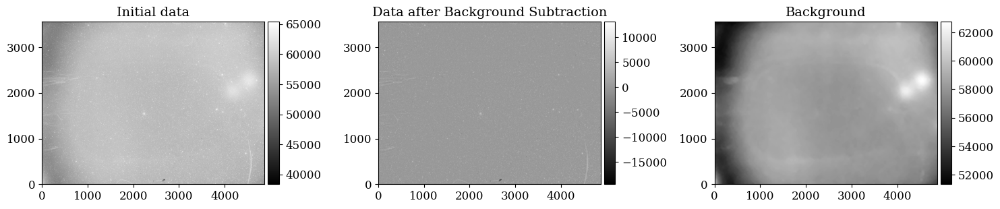

thresh  647.0929012298584
12328 objects found in segment 1


thresh  674.4712104797363
12601 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  644.817325592041
14097 objects found in segment 3


thresh  657.7289390563965
14071 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  53097


Processing files:  10%|██▏                   | 26/264 [26:35<4:12:54, 63.76s/it]

Processed sky_24-25.01.1987_10m_7S-3-9.fit (26/264) in 62.07 seconds.
-------------------------------------------


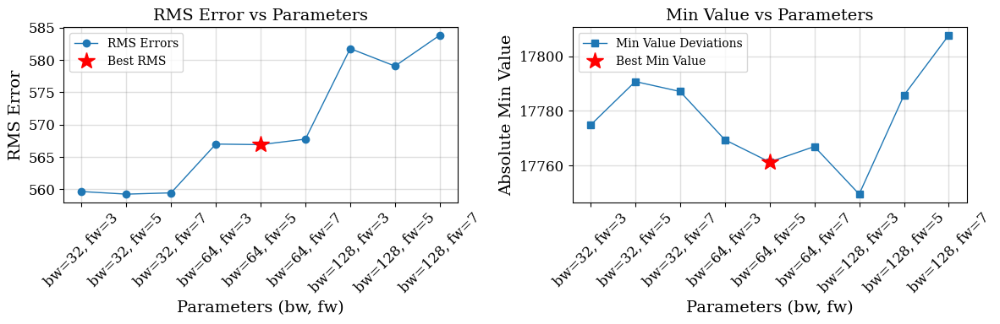

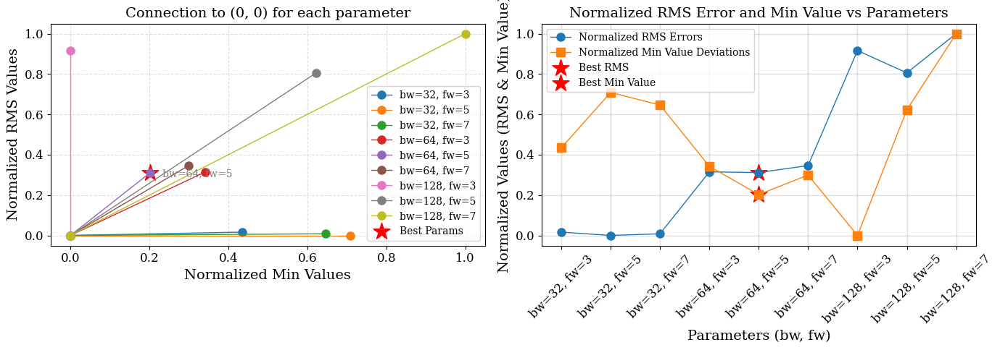

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-3-10.fit


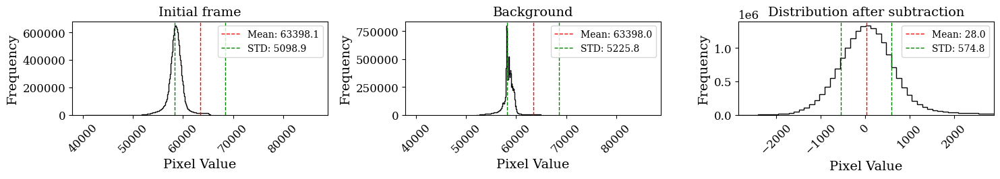

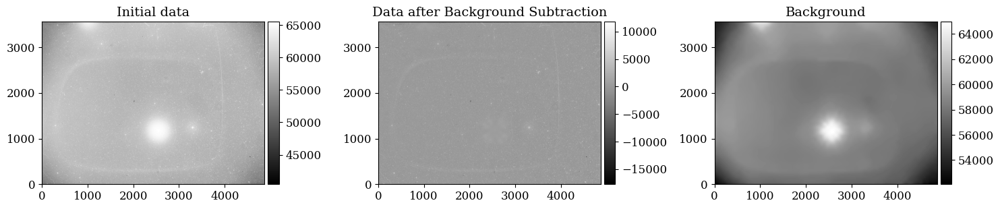

thresh  594.9778060913086
9281 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  621.0586585998535
9538 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  578.8761539459229
10059 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  589.9021873474121
10896 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  39774


Processing files:  10%|██▎                   | 27/264 [27:26<3:56:44, 59.94s/it]

Processed sky_24-25.01.1987_10m_7S-3-10.fit (27/264) in 51.02 seconds.
-------------------------------------------


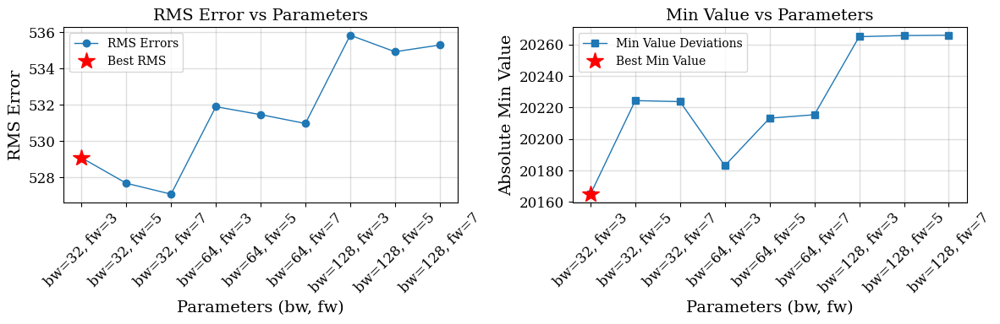

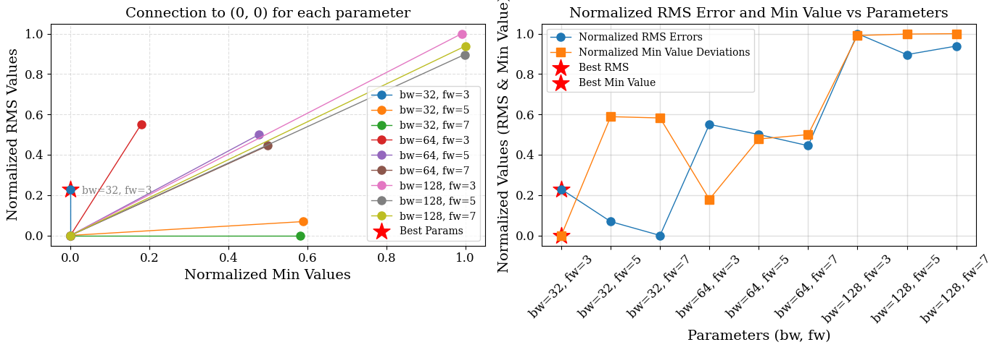

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_10m_7S-3-11.fit


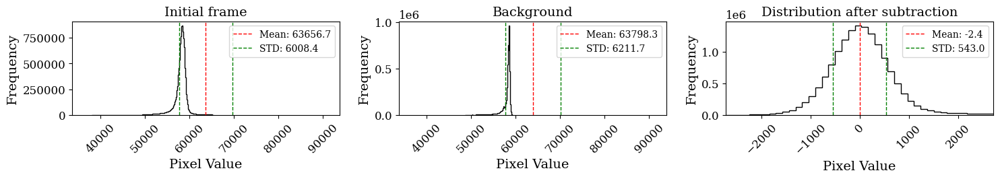

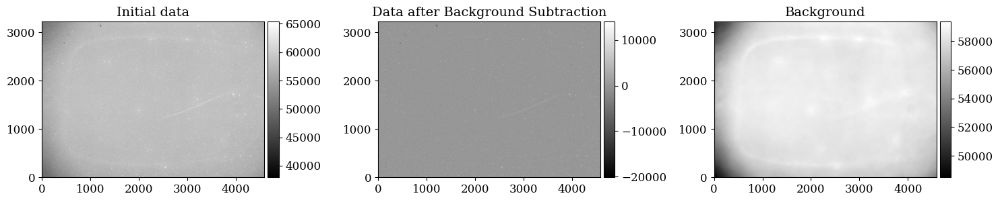

thresh  525.8392896652222
8940 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  531.4666402339935
8673 objects found in segment 2


thresh  522.336905002594
9072 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  527.9991124868393
8936 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  35621


Processing files:  11%|██▎                   | 28/264 [28:11<3:37:18, 55.25s/it]

Processed sky_24-25.01.1987_10m_7S-3-11.fit (28/264) in 44.30 seconds.
-------------------------------------------


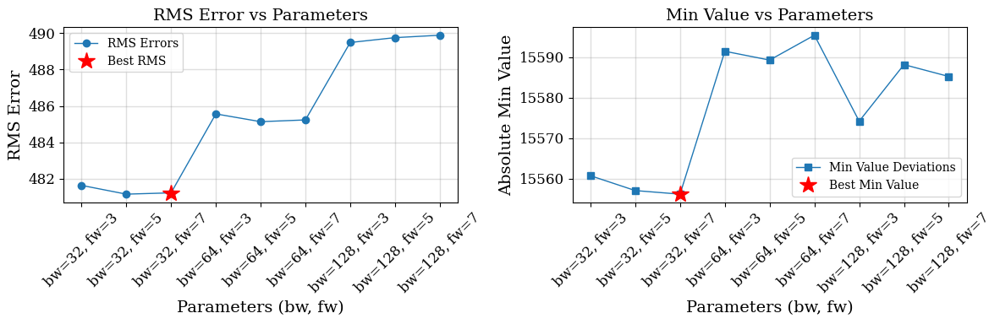

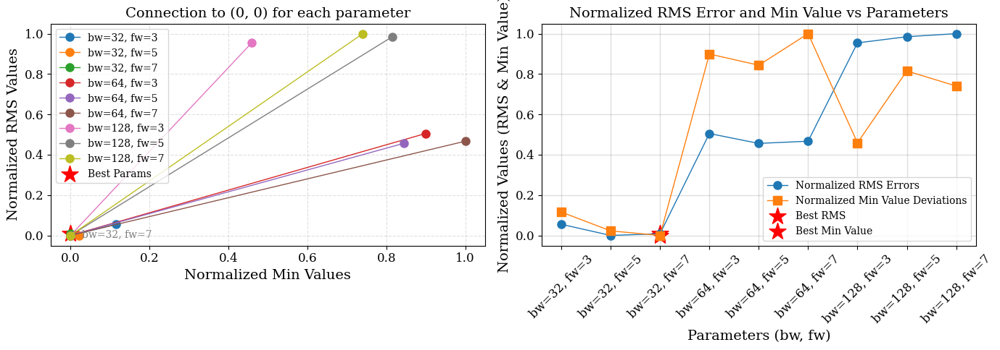

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_12m_7S-3-6.fit


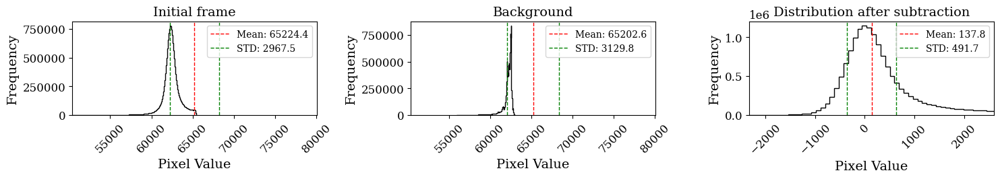

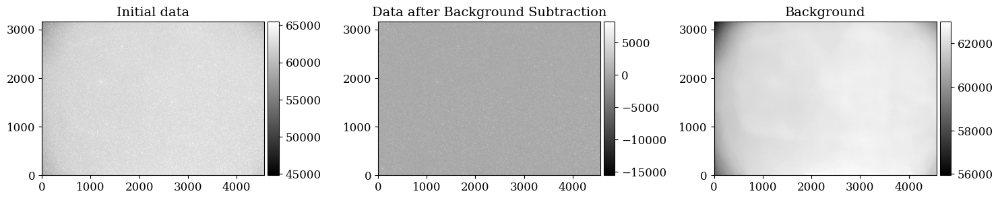

thresh  607.7621841430664
10372 objects found in segment 1


thresh  655.5737457275391
9053 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  605.6697158813477
14130 objects found in segment 3


thresh  623.9626922607422
12785 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  46340


Processing files:  11%|██▍                   | 29/264 [29:05<3:35:29, 55.02s/it]

Processed sky_24-25.01.1987_12m_7S-3-6.fit (29/264) in 54.49 seconds.
-------------------------------------------


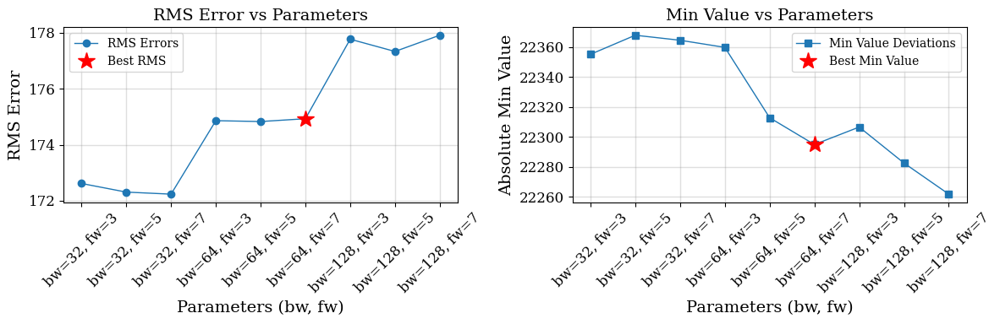

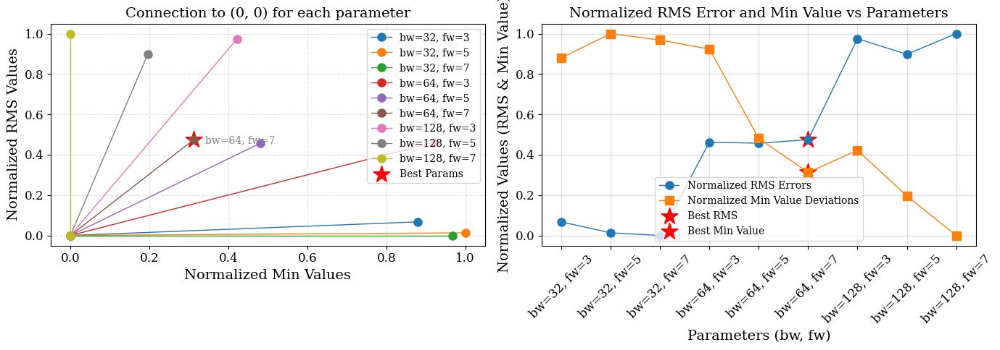

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_15m_7S-2-3.fit


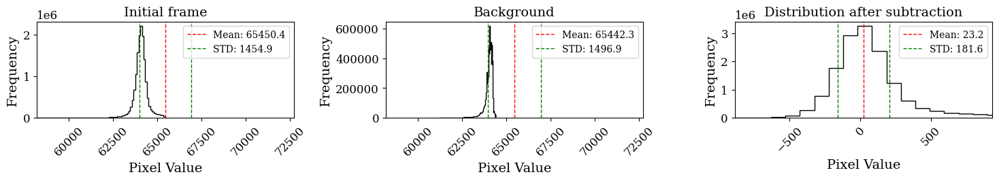

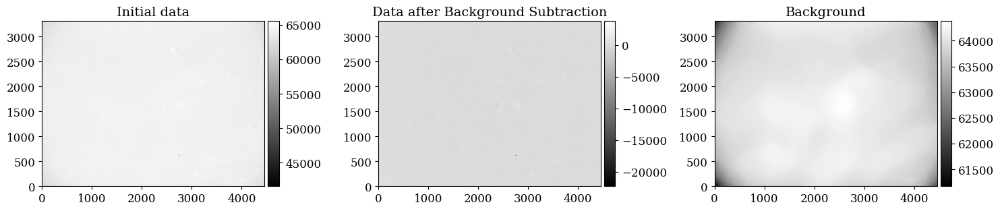

thresh  219.7942237854004
16589 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  196.4873447418213
13317 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  191.0600070953369
14665 objects found in segment 3


thresh  191.36280059814453
13670 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  58241


Processing files:  11%|██▌                   | 30/264 [30:18<3:55:21, 60.35s/it]

Processed sky_24-25.01.1987_15m_7S-2-3.fit (30/264) in 72.78 seconds.
-------------------------------------------


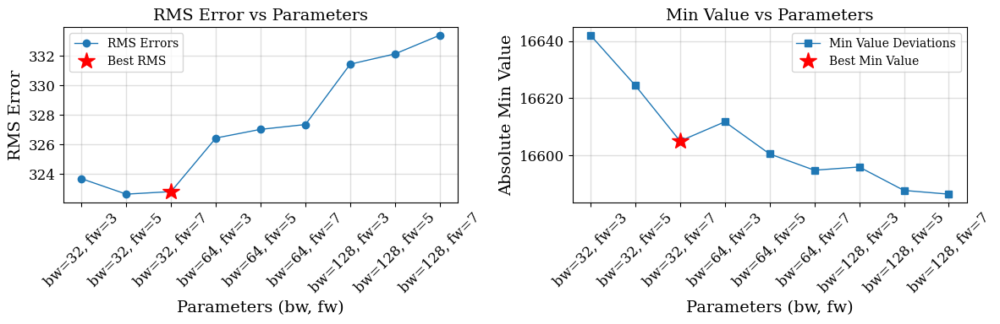

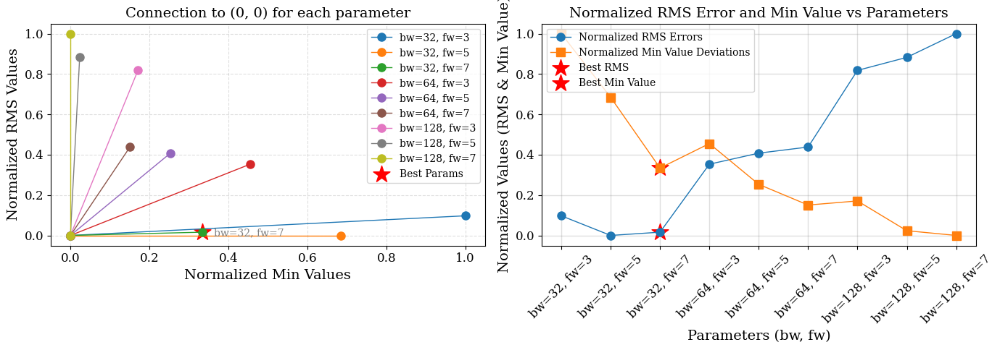

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/sky_24-25.01.1987_15m_7S-3-3.fit


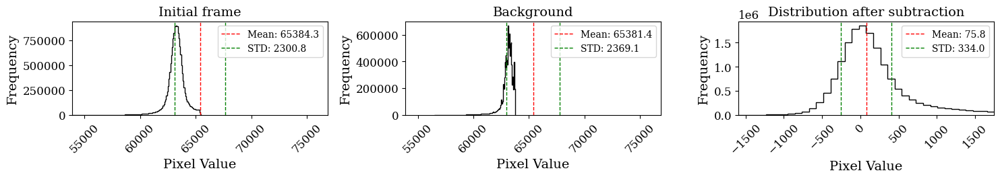

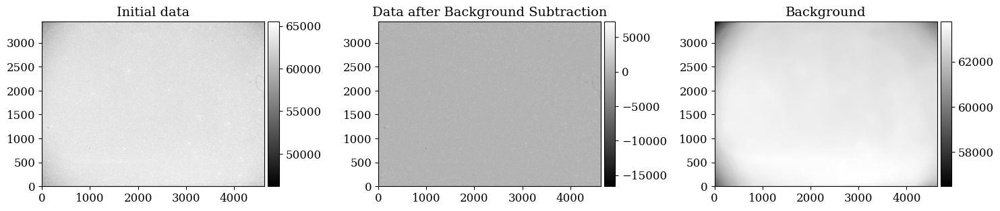

thresh  408.1870803833008
12834 objects found in segment 1


thresh  423.87805938720703
12237 objects found in segment 2


thresh  391.5206298828125
14122 objects found in segment 3


thresh  379.7651786804199
12902 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  52095


Processing files:  12%|██▌                   | 31/264 [31:40<4:19:41, 66.87s/it]

Processed sky_24-25.01.1987_15m_7S-3-3.fit (31/264) in 82.09 seconds.
-------------------------------------------


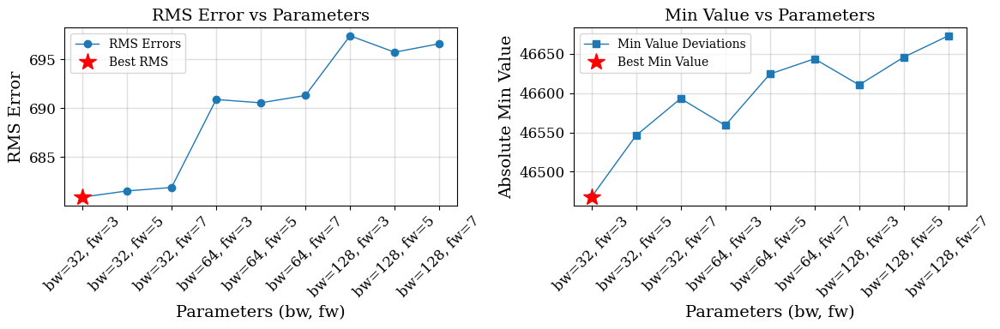

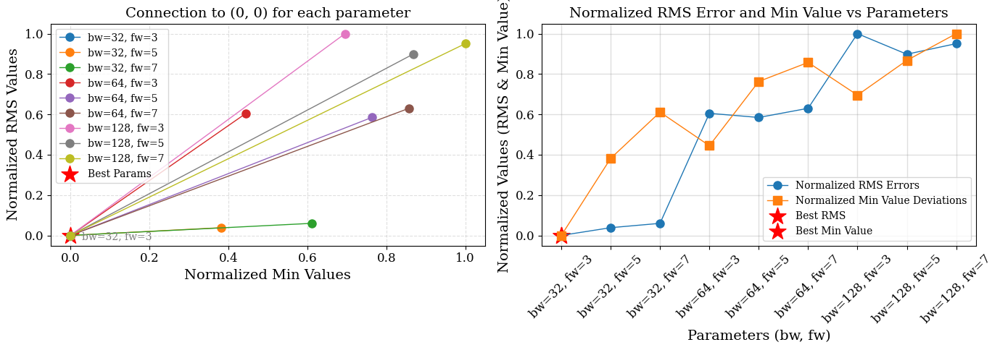

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_24-25.02.1987_8m_14S-2-2.fit


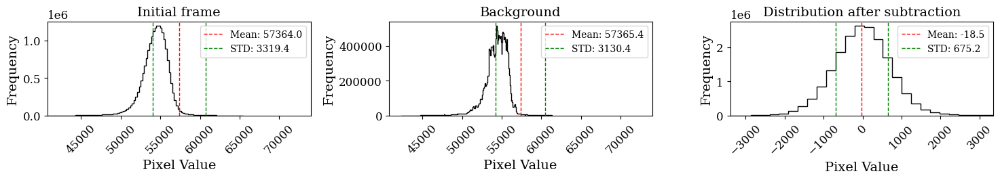

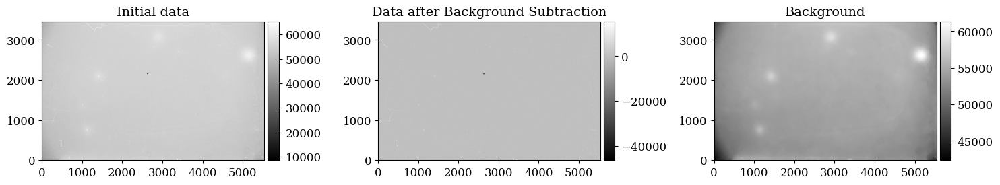

thresh  663.2992458343506
12721 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  660.1372184753418
13110 objects found in segment 2


thresh  661.2232933044434
10411 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  664.3063297271729
9780 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  46022


Processing files:  12%|██▋                   | 32/264 [32:40<4:10:41, 64.83s/it]

Processed Sky_24-25.02.1987_8m_14S-2-2.fit (32/264) in 60.08 seconds.
-------------------------------------------


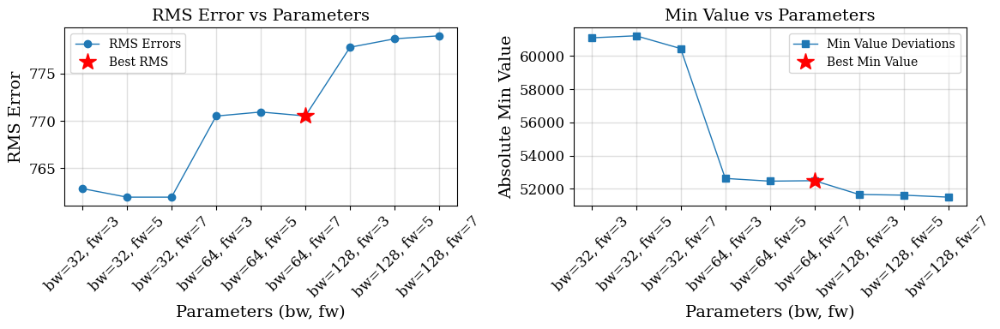

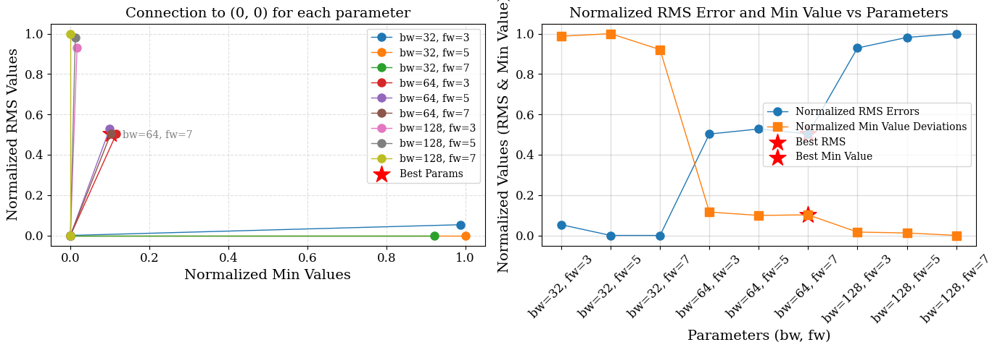

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_24-25.02.1987_8m_14S-2-3.fit


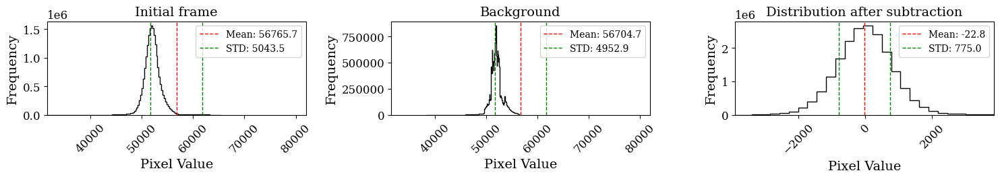

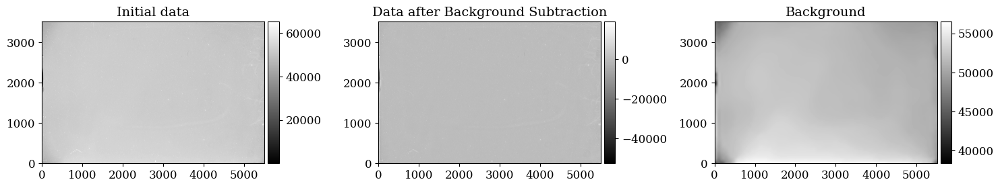

thresh  724.6714057922363
10316 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  753.2470207214355
11139 objects found in segment 2


thresh  748.0561790466309
11333 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  767.1830589771271
12112 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  44900


Processing files:  12%|██▊                   | 33/264 [35:38<6:20:42, 98.89s/it]

Processed Sky_24-25.02.1987_8m_14S-2-3.fit (33/264) in 178.34 seconds.
-------------------------------------------


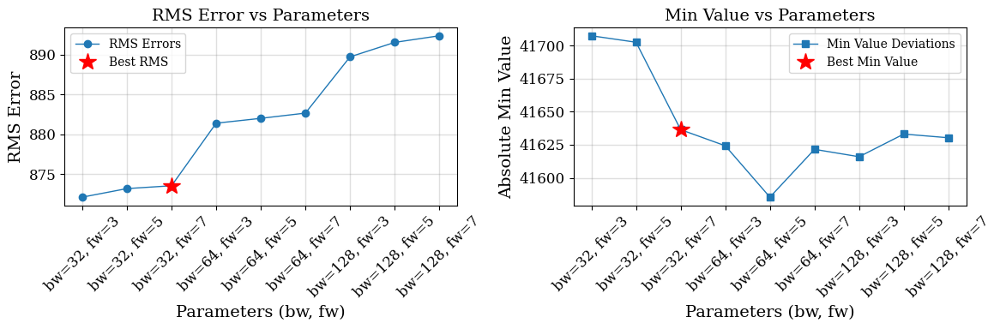

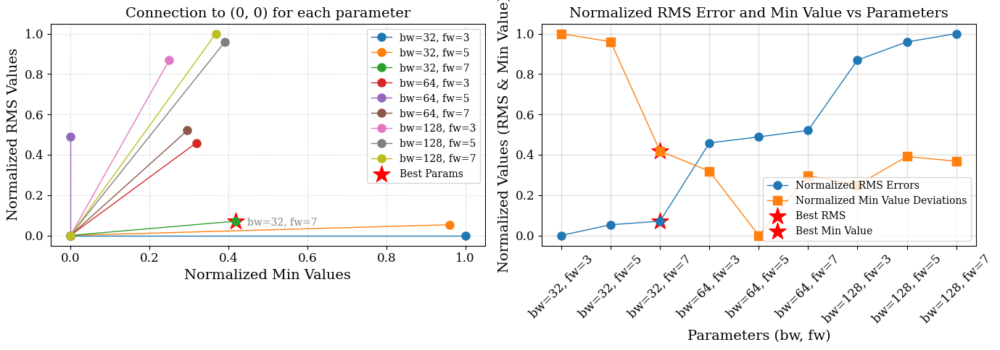

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_24-25.02.1987_8m_14S-2-9.fit


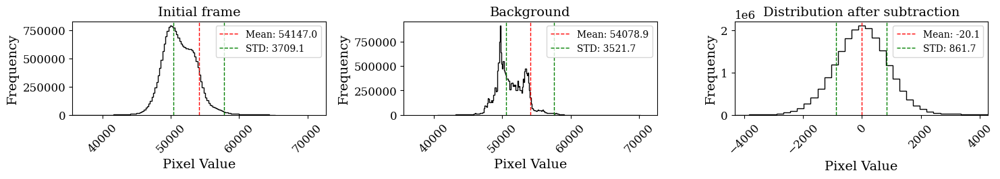

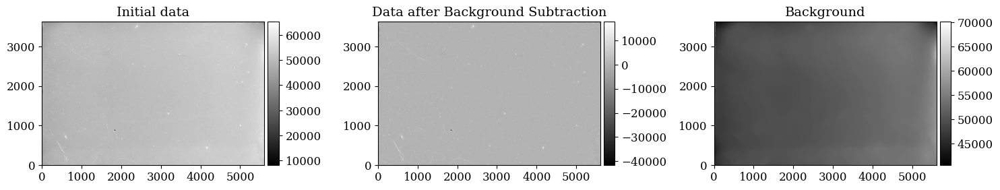

thresh  863.1033420562744
11945 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  850.6254615783691
10055 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  852.1099491119385
12302 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  848.7811145782471
9959 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  44261


Processing files:  13%|██▋                  | 34/264 [37:29<6:31:55, 102.24s/it]

Processed Sky_24-25.02.1987_8m_14S-2-9.fit (34/264) in 110.07 seconds.
-------------------------------------------


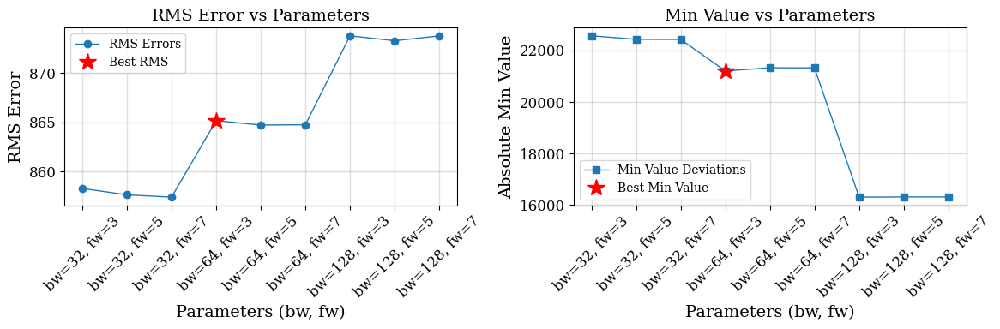

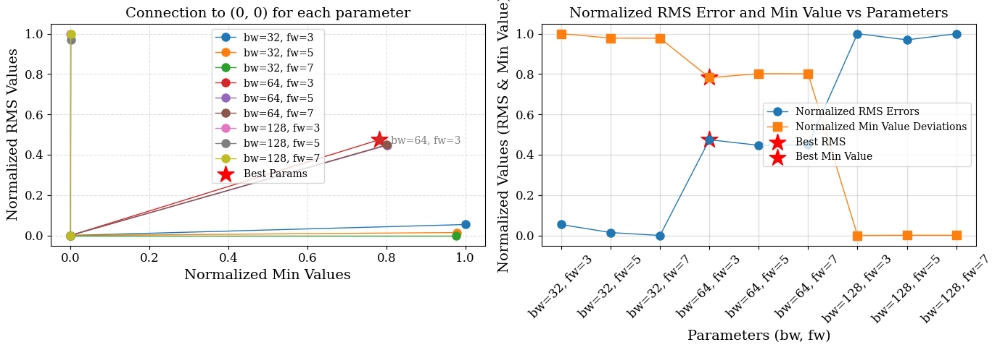

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_24-25.02.1987_8m_14S-2-10.fit


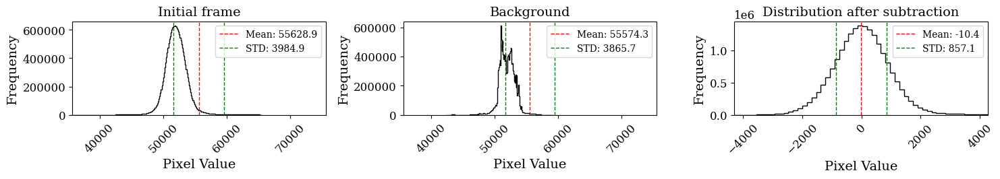

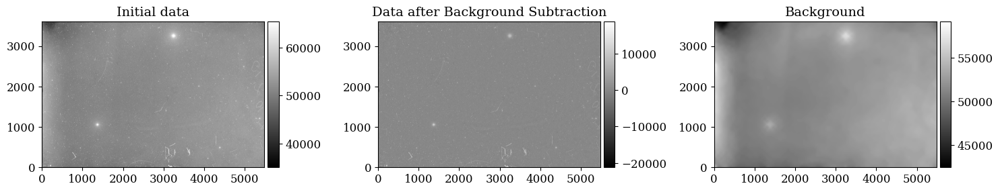

thresh  869.1764461994171
10123 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  851.6919631958008
10293 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  847.1243724822998
11049 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  852.2983283996582
10410 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  41875


Processing files:  13%|██▋                 | 35/264 [43:26<11:22:01, 178.70s/it]

Processed Sky_24-25.02.1987_8m_14S-2-10.fit (35/264) in 357.08 seconds.
-------------------------------------------


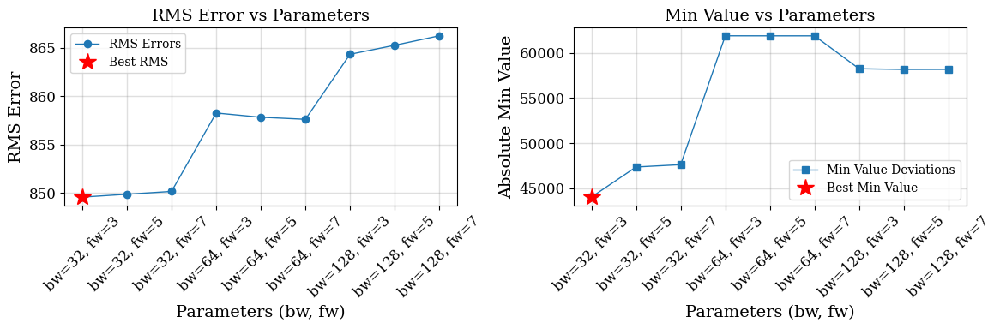

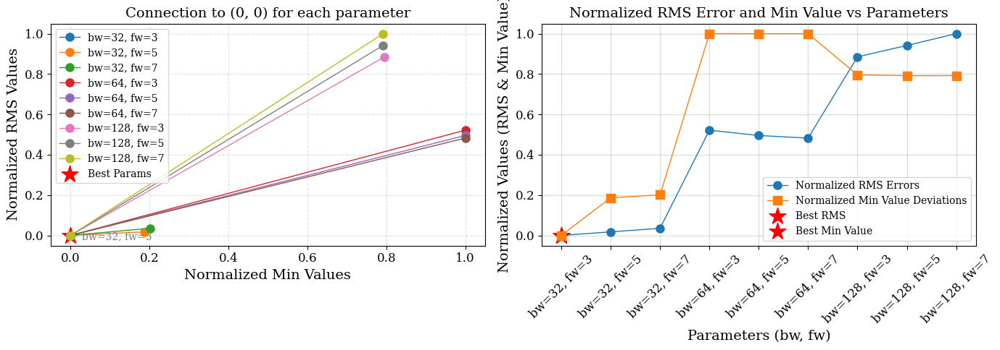

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_24-25.02.1987_8m_14S-2-11.fit


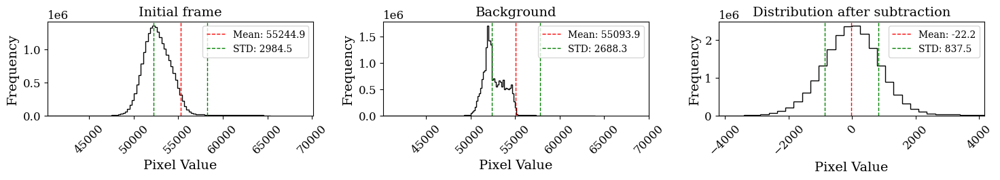

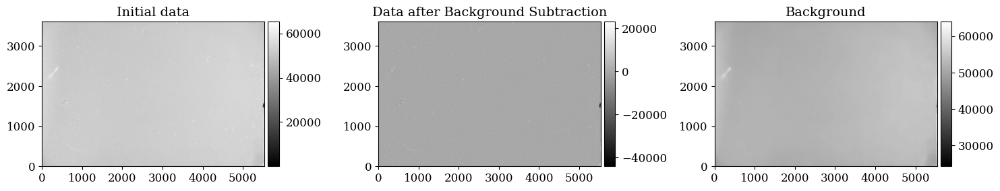

thresh  830.5868892669678
11206 objects found in segment 1


thresh  820.5388984680176
11029 objects found in segment 2


thresh  835.3855314254761
11151 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  823.305685043335
10726 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  44112


Processing files:  14%|██▊                  | 36/264 [44:21<8:58:26, 141.69s/it]

Processed Sky_24-25.02.1987_8m_14S-2-11.fit (36/264) in 55.36 seconds.
-------------------------------------------


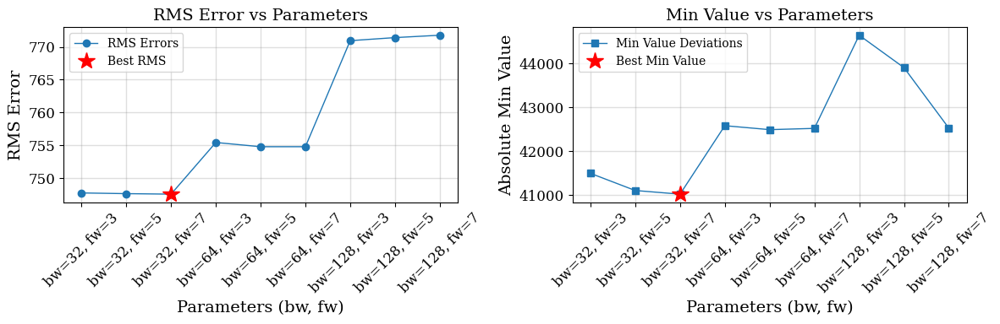

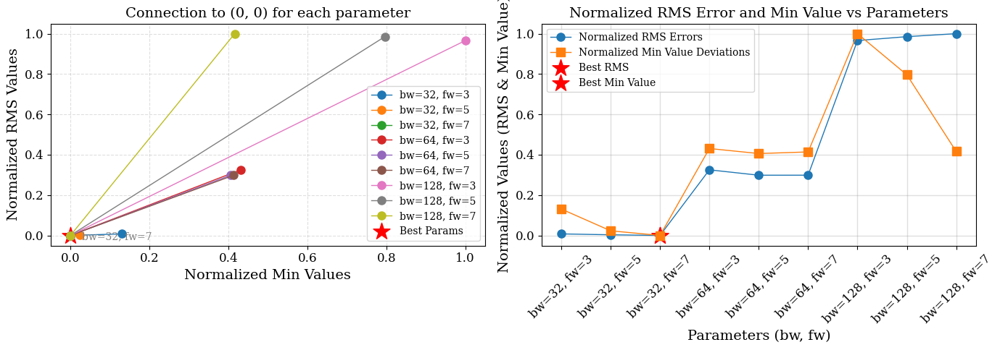

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_24-25.02.1987_8m_14S-3-2.fit


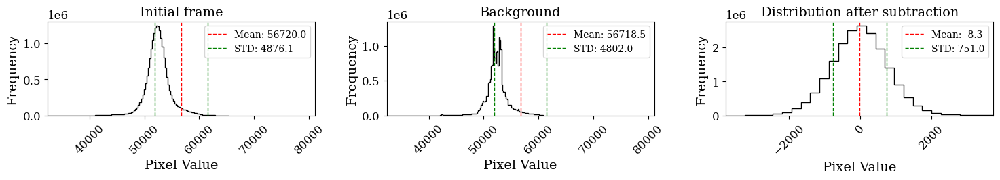

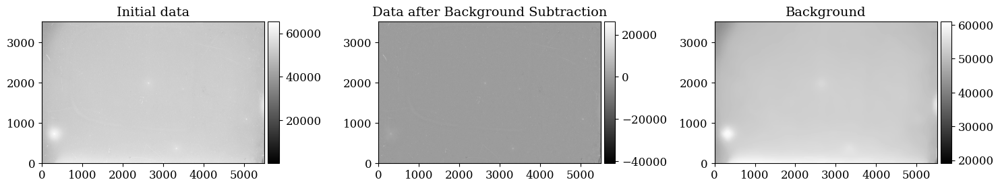

thresh  756.3972587585449
8561 objects found in segment 1


thresh  731.1518745422363
9657 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  740.5216135978699
13152 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  728.2375144958496
12567 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  43937


Processing files:  14%|██▉                  | 37/264 [45:15<7:16:57, 115.49s/it]

Processed Sky_24-25.02.1987_8m_14S-3-2.fit (37/264) in 54.36 seconds.
-------------------------------------------


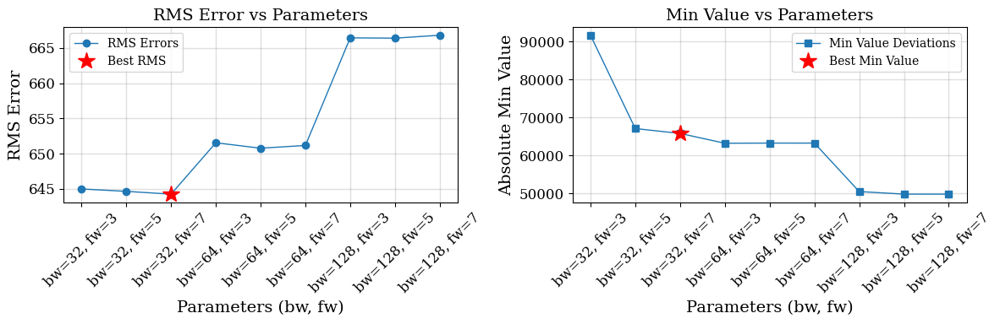

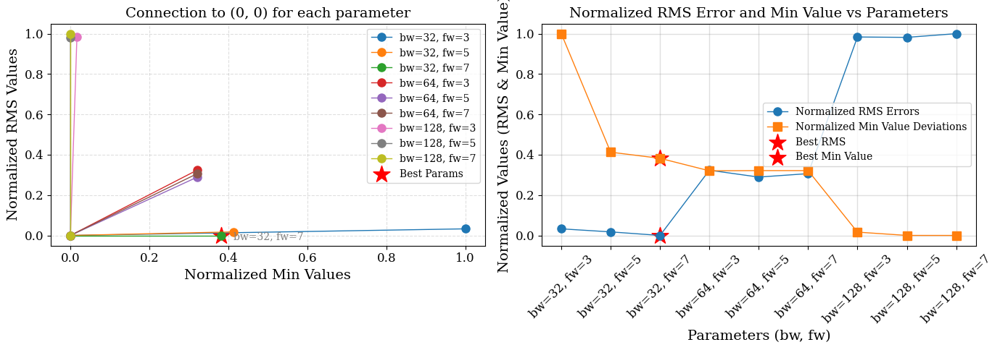

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_24-25.02.1987_8m_14S-3-3.fit


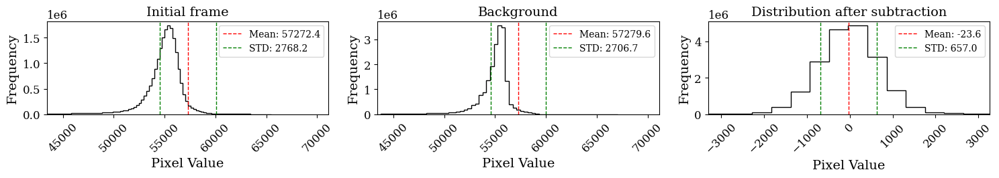

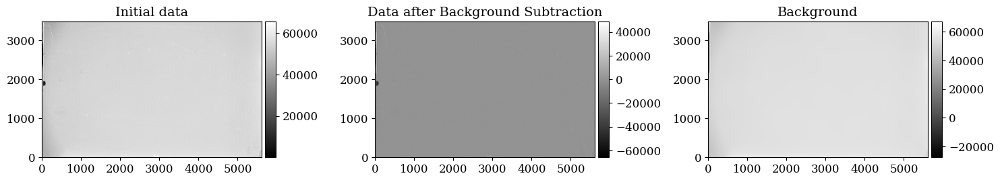

thresh  615.0251941680908
11857 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  620.2289714813232
10003 objects found in segment 2


thresh  621.552734375
13931 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  624.3360977172852
11884 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  47675


Processing files:  14%|███▏                  | 38/264 [46:15<6:12:02, 98.77s/it]

Processed Sky_24-25.02.1987_8m_14S-3-3.fit (38/264) in 59.75 seconds.
-------------------------------------------


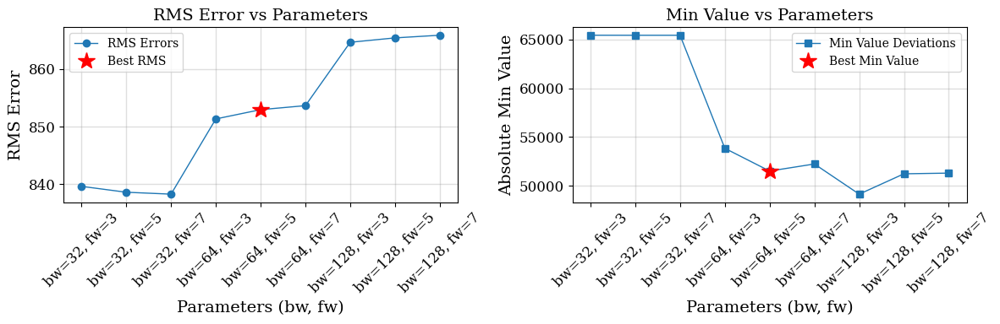

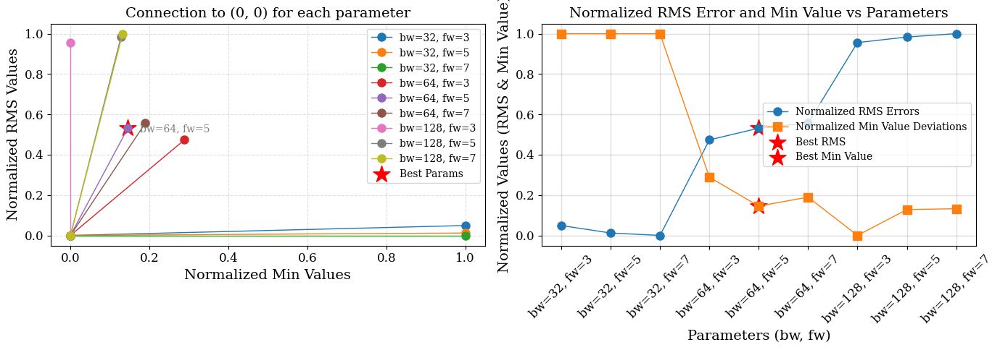

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_24-25.02.1987_8m_14S-3-8.fit


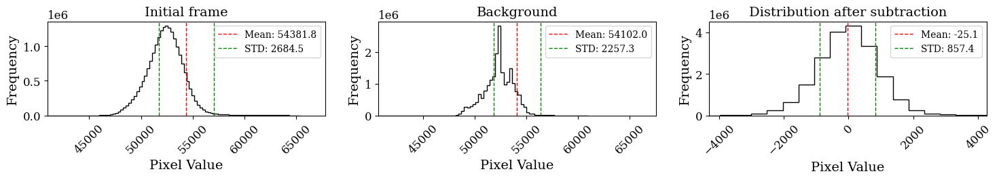

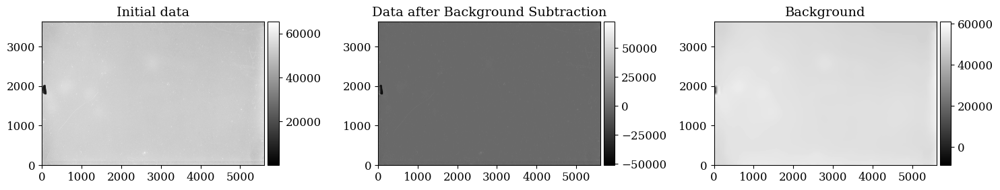

thresh  809.6255416870117
10360 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  815.4562797546387
10933 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  842.6838369369507
11265 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  844.3249092102051
11359 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  43917


Processing files:  15%|███▎                  | 39/264 [47:11<5:22:22, 85.97s/it]

Processed Sky_24-25.02.1987_8m_14S-3-8.fit (39/264) in 56.08 seconds.
-------------------------------------------


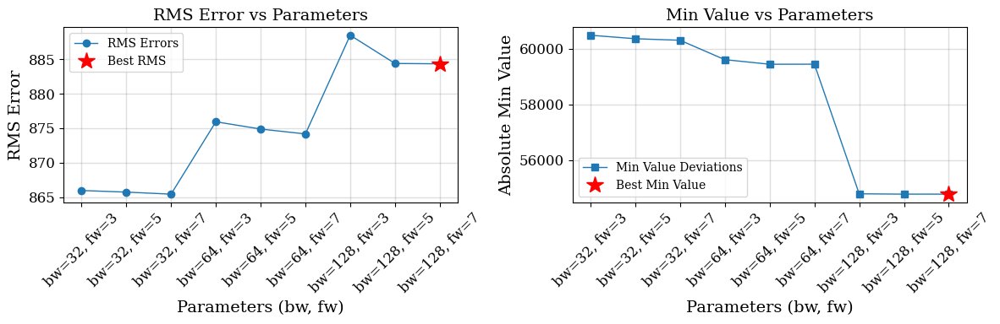

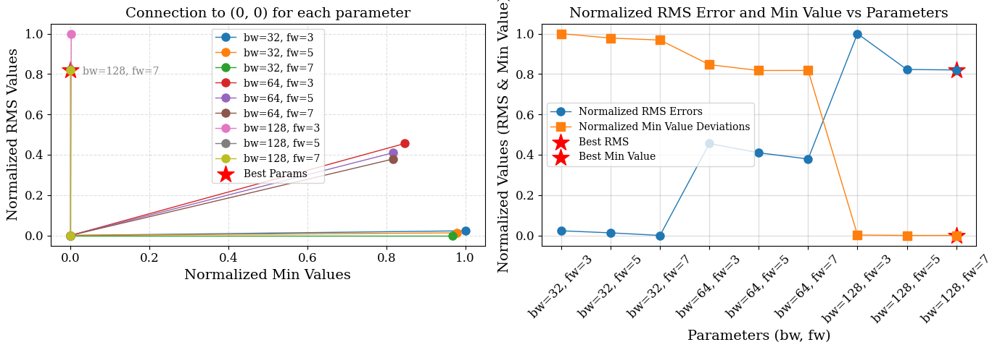

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_24-25.02.1987_8m_14S-3-9.fit


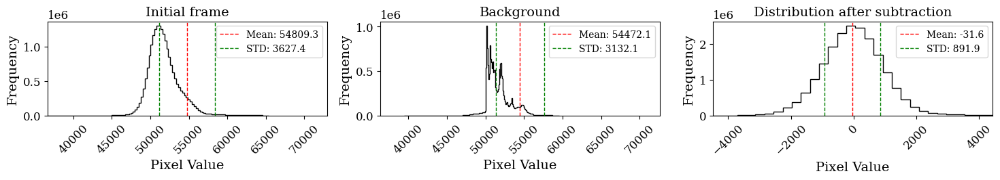

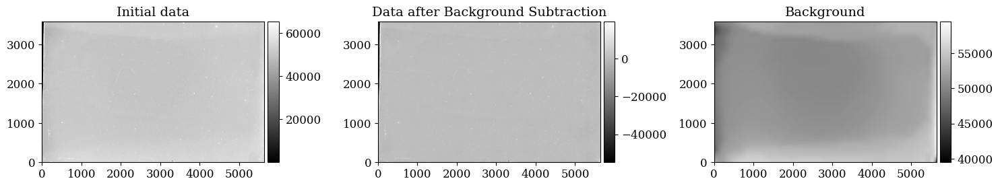

thresh  874.8109550476074
10410 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  828.7372627258301
9557 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  858.9590034484863
11424 objects found in segment 3


thresh  848.2058868408203
10694 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  42085


Processing files:  15%|███▎                  | 40/264 [48:05<4:45:26, 76.46s/it]

Processed Sky_24-25.02.1987_8m_14S-3-9.fit (40/264) in 54.28 seconds.
-------------------------------------------


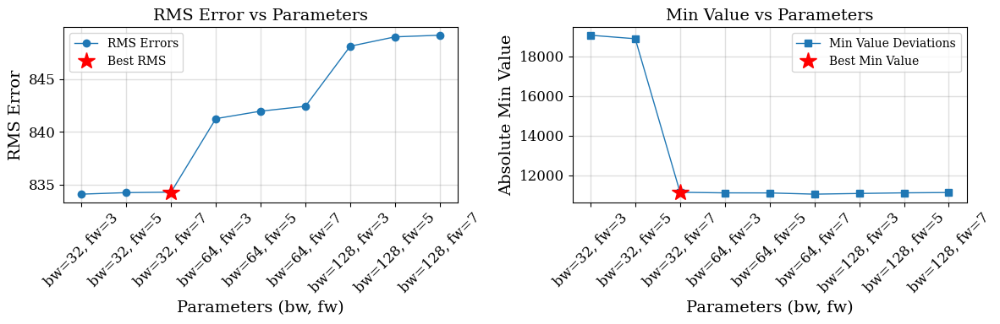

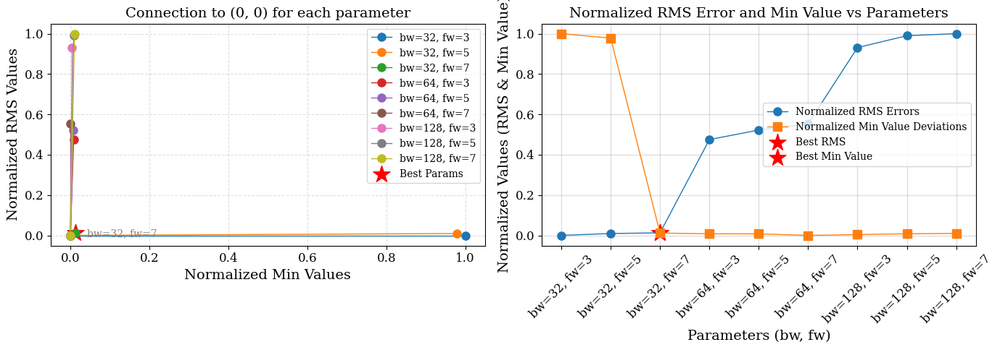

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_24-25.02.1987_8m_14S-3-10.fit


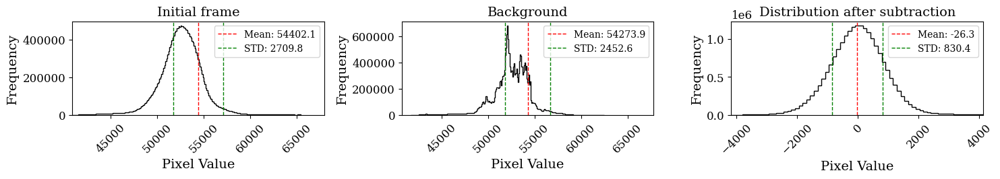

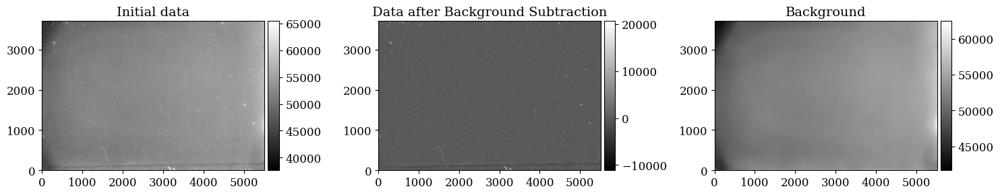

thresh  809.5351467132568
12489 objects found in segment 1


thresh  794.7540016174316
10330 objects found in segment 2


thresh  818.2284336090088
13203 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  808.823486328125
10436 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  46458


Processing files:  16%|███▍                  | 41/264 [49:02<4:22:20, 70.59s/it]

Processed Sky_24-25.02.1987_8m_14S-3-10.fit (41/264) in 56.88 seconds.
-------------------------------------------


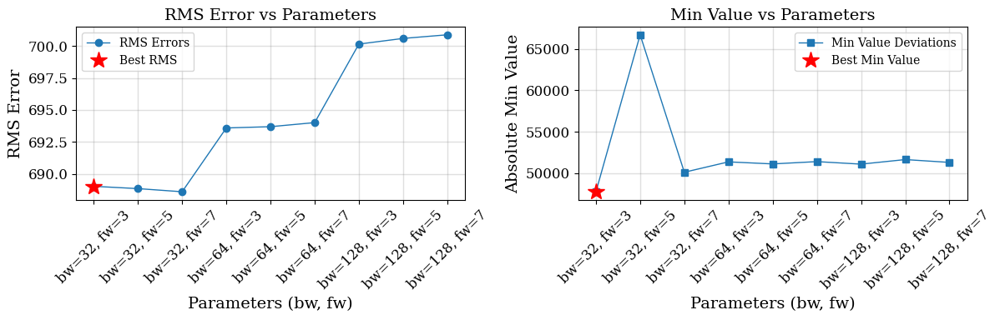

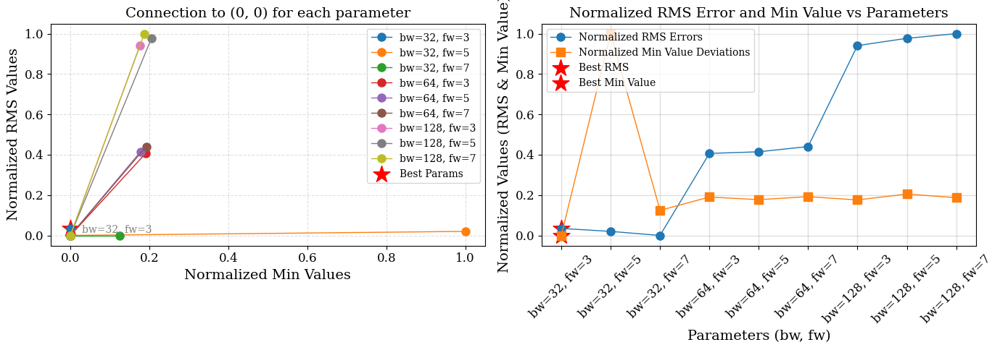

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_24-25.02.1987_9m_14S-2-4.fit


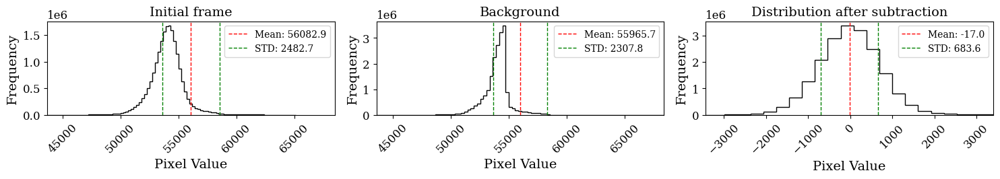

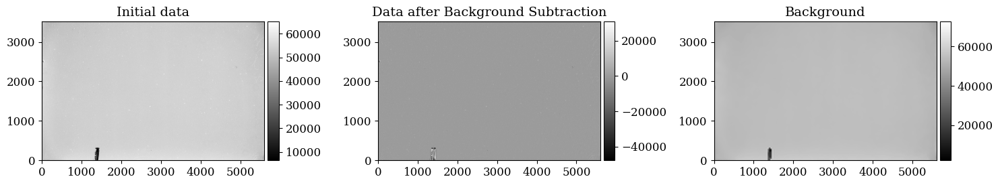

thresh  668.8024482727051
10307 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  671.2728862762451
10953 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  675.4452838897705
11900 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  673.0641012191772
11748 objects found in segment 4


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


TOTAL NUMBER OF FOUND OBJECTS  44908


Processing files:  16%|███▌                  | 42/264 [49:57<4:03:39, 65.85s/it]

Processed Sky_24-25.02.1987_9m_14S-2-4.fit (42/264) in 54.81 seconds.
-------------------------------------------


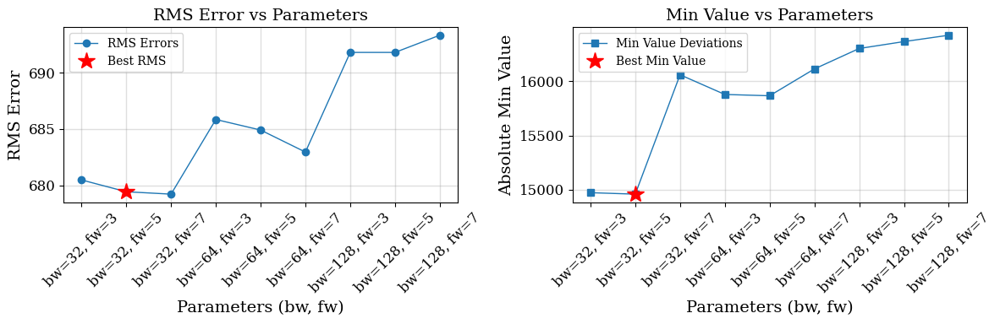

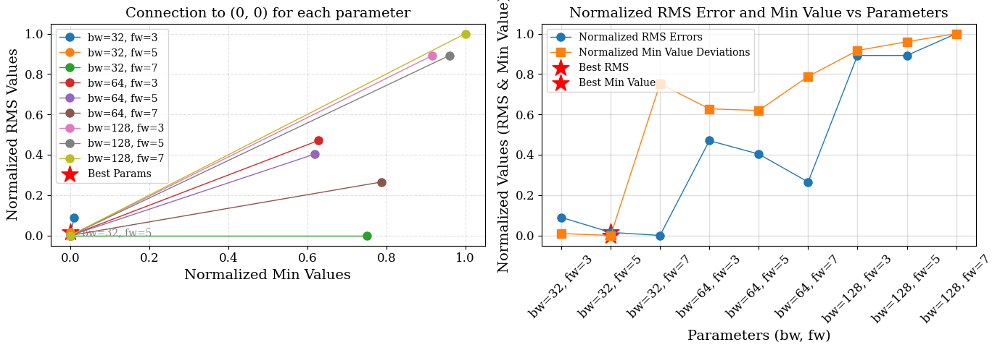

Processing file: /Volumes/astroplates2/schmidt_telescope_lc/variable_search/schmidt_var_search_frames/Sky_24-25.02.1987_10m_14S-3-11.fit


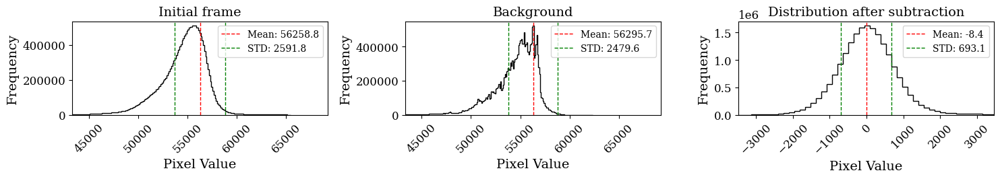

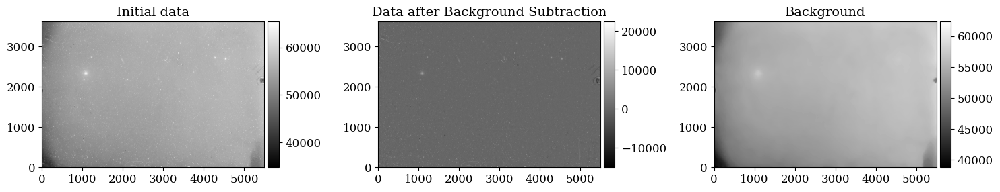

thresh  684.1661787033081
14870 objects found in segment 1


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  665.4746322631836
11384 objects found in segment 2


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  676.7887423038483
11443 objects found in segment 3


/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_8717/4125569818.py:74: RuntimeWarning: invalid value encountered in log10
  mag = -2.5 * np.log10(flux)


thresh  662.8012218475342
8716 objects found in segment 4


TOTAL NUMBER OF FOUND OBJECTS  46413


Processing files:  16%|███▌                  | 42/264 [50:54<4:29:03, 72.72s/it]

KeyboardInterrupt



Error in callback <function _draw_all_if_interactive at 0x16a556840> (for post_execute), with arguments args (),kwargs {}:


KeyboardInterrupt: 

Error in callback <function flush_figures at 0x28e846de0> (for post_execute), with arguments args (),kwargs {}:



KeyboardInterrupt



In [20]:
process_directory_export_objects(fits_directory, output_directory,scale='zscale')